# 0. Setup Paths

In [1]:
import os

In [2]:
CUSTOM_MODEL_NAME = 'my_ssd_mobnet' 
PRETRAINED_MODEL_NAME = 'ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8'
PRETRAINED_MODEL_URL = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz'
TF_RECORD_SCRIPT_NAME = 'generate_tfrecord.py'
LABEL_MAP_NAME = 'label_map.pbtxt'

In [3]:
paths = {
    'WORKSPACE_PATH': os.path.join('Tensorflow', 'workspace'),
    'SCRIPTS_PATH': os.path.join('Tensorflow','scripts'),
    'APIMODEL_PATH': os.path.join('Tensorflow','models'),
    'ANNOTATION_PATH': os.path.join('Tensorflow', 'workspace','annotations'),
    'IMAGE_PATH': os.path.join('Tensorflow', 'workspace','images'),
    'MODEL_PATH': os.path.join('Tensorflow', 'workspace','models'),
    'PRETRAINED_MODEL_PATH': os.path.join('Tensorflow', 'workspace','pre-trained-models'),
    'CHECKPOINT_PATH': os.path.join('Tensorflow', 'workspace','models',CUSTOM_MODEL_NAME), 
    'OUTPUT_PATH': os.path.join('Tensorflow', 'workspace','models',CUSTOM_MODEL_NAME, 'export'), 
    'TFJS_PATH':os.path.join('Tensorflow', 'workspace','models',CUSTOM_MODEL_NAME, 'tfjsexport'), 
    'TFLITE_PATH':os.path.join('Tensorflow', 'workspace','models',CUSTOM_MODEL_NAME, 'tfliteexport'), 
    'PROTOC_PATH':os.path.join('Tensorflow','protoc')
 }

In [4]:
files = {
    'PIPELINE_CONFIG':os.path.join('Tensorflow', 'workspace','models', CUSTOM_MODEL_NAME, 'pipeline.config'),
    'TF_RECORD_SCRIPT': os.path.join(paths['SCRIPTS_PATH'], TF_RECORD_SCRIPT_NAME), 
    'LABELMAP': os.path.join(paths['ANNOTATION_PATH'], LABEL_MAP_NAME)
}

In [5]:
for path in paths.values():
    if not os.path.exists(path):
        if os.name == 'posix':
            !mkdir -p {path}
        if os.name == 'nt':
            !mkdir {path}

# 1. Download TF Models Pretrained Models from Tensorflow Model Zoo and Install TFOD

In [9]:
# https://www.tensorflow.org/install/source_windows

In [6]:
if os.name=='nt':
    !pip install wget
    import wget

You should consider upgrading via the 'D:\Akshat jain\tpddl\TFODCourse\atul\Scripts\python.exe -m pip install --upgrade pip' command.
You should consider upgrading via the 'D:\Akshat jain\tpddl\TFODCourse\atul\Scripts\python.exe -m pip install --upgrade pip' command.


In [7]:
if not os.path.exists(os.path.join(paths['APIMODEL_PATH'], 'research', 'object_detection')):
    !git clone https://github.com/tensorflow/models {paths['APIMODEL_PATH']}

In [8]:
# Install Tensorflow Object Detection 
if os.name=='posix':  
    !apt-get install protobuf-compiler
    !cd Tensorflow/models/research && protoc object_detection/protos/*.proto --python_out=. && cp object_detection/packages/tf2/setup.py . && python -m pip install . 
    
if os.name=='nt':
    url="https://github.com/protocolbuffers/protobuf/releases/download/v3.15.6/protoc-3.15.6-win64.zip"
    wget.download(url)
    !move protoc-3.15.6-win64.zip {paths['PROTOC_PATH']}
    !cd {paths['PROTOC_PATH']} && tar -xf protoc-3.15.6-win64.zip
    os.environ['PATH'] += os.pathsep + os.path.abspath(os.path.join(paths['PROTOC_PATH'], 'bin'))   
    !cd Tensorflow/models/research && protoc object_detection/protos/*.proto --python_out=. && copy object_detection\\packages\\tf2\\setup.py setup.py && python setup.py build && python setup.py install
    !cd Tensorflow/models/research/slim && pip install -e . 

100% [..........................................................................] 1468733 / 1468733        1 file(s) moved.
        1 file(s) moved.
        1 file(s) copied.
running build
running build_py
copying object_detection\protos\anchor_generator_pb2.py -> build\lib\object_detection\protos
copying object_detection\protos\argmax_matcher_pb2.py -> build\lib\object_detection\protos
copying object_detection\protos\bipartite_matcher_pb2.py -> build\lib\object_detection\protos
copying object_detection\protos\box_coder_pb2.py -> build\lib\object_detection\protos
copying object_detection\protos\box_predictor_pb2.py -> build\lib\object_detection\protos
copying object_detection\protos\calibration_pb2.py -> build\lib\object_detection\protos
copying object_detection\protos\center_net_pb2.py -> build\lib\object_detection\protos
copying object_detection\protos\eval_pb2.py -> build\lib\object_detection\protos
copying object_detection\protos\faster_rcnn_box_coder_pb2.py -> build\lib\object_det

zip_safe flag not set; analyzing archive contents...
object_detection.core.__pycache__.densepose_ops.cpython-310: module references __file__
object_detection.core.__pycache__.preprocessor.cpython-310: module MAY be using inspect.stack
object_detection.utils.__pycache__.autoaugment_utils.cpython-310: module MAY be using inspect.stack
error: numpy 1.23.5 is installed but numpy<1.22.0,>=1.14.3 is required by {'apache-beam'}
zip_safe flag not set; analyzing archive contents...
object_detection.core.__pycache__.densepose_ops.cpython-310: module references __file__
object_detection.core.__pycache__.preprocessor.cpython-310: module MAY be using inspect.stack
object_detection.utils.__pycache__.autoaugment_utils.cpython-310: module MAY be using inspect.stack
error: numpy 1.23.5 is installed but numpy<1.22.0,>=1.14.3 is required by {'apache-beam'}



copying build\lib\datasets\dataset_factory.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\dataset_utils.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\download_and_convert_cifar10.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\download_and_convert_flowers.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\download_and_convert_mnist.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\download_and_convert_visualwakewords.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\download_and_convert_visualwakewords_lib.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\flowers.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\imagenet.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\mnist.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\preprocess_imagenet_validation_data.py -> build\bdist.win-amd64\egg\datasets


copying build\lib\datasets\dataset_factory.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\dataset_utils.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\download_and_convert_cifar10.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\download_and_convert_flowers.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\download_and_convert_mnist.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\download_and_convert_visualwakewords.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\download_and_convert_visualwakewords_lib.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\flowers.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\imagenet.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\mnist.py -> build\bdist.win-amd64\egg\datasets
copying build\lib\datasets\preprocess_imagenet_validation_data.py -> build\bdist.win-amd64\egg\datasets

Obtaining file:///D:/Akshat%20jain/tpddl/TFODCourse/Tensorflow/models/research/slim
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Attempting uninstall: slim
    Found existing installation: slim 0.1
    Uninstalling slim-0.1:
      Successfully uninstalled slim-0.1
  Running setup.py develop for slim


You should consider upgrading via the 'D:\Akshat jain\tpddl\TFODCourse\atul\Scripts\python.exe -m pip install --upgrade pip' command.


Obtaining file:///D:/Akshat%20jain/tpddl/TFODCourse/Tensorflow/models/research/slim
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Attempting uninstall: slim
    Found existing installation: slim 0.1
    Uninstalling slim-0.1:
      Successfully uninstalled slim-0.1
  Running setup.py develop for slim


You should consider upgrading via the 'D:\Akshat jain\tpddl\TFODCourse\atul\Scripts\python.exe -m pip install --upgrade pip' command.


In [16]:
VERIFICATION_SCRIPT = os.path.join(paths['APIMODEL_PATH'], 'research', 'object_detection', 'builders', 'model_builder_tf2_test.py')
# Verify Installation
!python {VERIFICATION_SCRIPT}

2021-04-03 11:13:18.258898: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library cudart64_110.dll
Running tests under Python 3.7.3: D:\YouTube\OD\TFODCourse\tfod\Scripts\python.exe
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model
2021-04-03 11:13:24.537172: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library nvcuda.dll
2021-04-03 11:13:24.563275: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1733] Found device 0 with properties: 
pciBusID: 0000:2b:00.0 name: GeForce RTX 2070 SUPER computeCapability: 7.5
coreClock: 1.785GHz coreCount: 40 deviceMemorySize: 8.00GiB deviceMemoryBandwidth: 417.29GiB/s
2021-04-03 11:13:24.563310: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library cudart64_110.dll
2021-04-03 11:13:25.034685: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library cublas64_1

I0403 11:13:37.327793  4864 efficientnet_model.py:147] round_filter input=40 output=80
I0403 11:13:37.327793  4864 efficientnet_model.py:147] round_filter input=80 output=160
I0403 11:13:37.769363  4864 efficientnet_model.py:147] round_filter input=80 output=160
I0403 11:13:37.769363  4864 efficientnet_model.py:147] round_filter input=112 output=224
I0403 11:13:38.237657  4864 efficientnet_model.py:147] round_filter input=112 output=224
I0403 11:13:38.237657  4864 efficientnet_model.py:147] round_filter input=192 output=384
I0403 11:13:39.077081  4864 efficientnet_model.py:147] round_filter input=192 output=384
I0403 11:13:39.077081  4864 efficientnet_model.py:147] round_filter input=320 output=640
I0403 11:13:39.359760  4864 efficientnet_model.py:147] round_filter input=1280 output=2560
I0403 11:13:39.393760  4864 efficientnet_model.py:458] Building model efficientnet with params ModelConfig(width_coefficient=2.0, depth_coefficient=3.1, resolution=600, dropout_rate=0.5, blocks=(BlockC

In [15]:
!pip install tensorflow --upgrade

  Using cached astunparse-1.6.3-py2.py3-none-any.whl (12 kB)
  Using cached flatbuffers-1.12-py2.py3-none-any.whl (15 kB)
  Using cached gast-0.4.0-py3-none-any.whl (9.8 kB)
  Using cached google_pasta-0.2.0-py3-none-any.whl (57 kB)
  Using cached grpcio-1.34.1-cp37-cp37m-win_amd64.whl (2.9 MB)
  Using cached h5py-3.1.0-cp37-cp37m-win_amd64.whl (2.7 MB)
  Using cached keras_nightly-2.5.0.dev2021032900-py2.py3-none-any.whl (1.2 MB)
  Using cached Keras_Preprocessing-1.1.2-py2.py3-none-any.whl (42 kB)
  Using cached opt_einsum-3.3.0-py3-none-any.whl (65 kB)
  Using cached tensorboard-2.4.1-py3-none-any.whl (10.6 MB)
  Using cached termcolor-1.1.0-py3-none-any.whl
  Using cached tf_estimator_nightly-2.5.0.dev2021032501-py2.py3-none-any.whl (462 kB)
  Using cached wrapt-1.12.1-cp37-cp37m-win_amd64.whl
  Using cached cached_property-1.5.2-py2.py3-none-any.whl (7.6 kB)
  Using cached google_auth_oauthlib-0.4.4-py2.py3-none-any.whl (18 kB)
  Using cached Markdown-3.3.4-py3-none-any.whl (97 kB

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
apache-beam 2.28.0 requires crcmod<2.0,>=1.7, which is not installed.
apache-beam 2.28.0 requires dill<0.3.2,>=0.3.1.1, which is not installed.
apache-beam 2.28.0 requires fastavro<2,>=0.21.4, which is not installed.
apache-beam 2.28.0 requires future<1.0.0,>=0.18.2, which is not installed.
apache-beam 2.28.0 requires hdfs<3.0.0,>=2.1.0, which is not installed.
apache-beam 2.28.0 requires httplib2<0.18.0,>=0.8, which is not installed.
apache-beam 2.28.0 requires mock<3.0.0,>=1.0.1, which is not installed.
tensorflow-datasets 4.2.0 requires attrs>=18.1.0, which is not installed.
tensorflow-datasets 4.2.0 requires dill, which is not installed.
tensorflow-datasets 4.2.0 requires future, which is not installed.
tensorflow-datasets 4.2.0 requires importlib-resources, which is not installed.
tensorflow-datasets 4.2.0 re

In [13]:
!pip uninstall protobuf matplotlib -y
!pip install protobuf matplotlib==3.2

Found existing installation: protobuf 3.15.7
Uninstalling protobuf-3.15.7:
  Successfully uninstalled protobuf-3.15.7
Found existing installation: matplotlib 3.4.1
Uninstalling matplotlib-3.4.1:
  Successfully uninstalled matplotlib-3.4.1

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
apache-beam 2.28.0 requires crcmod<2.0,>=1.7, which is not installed.
apache-beam 2.28.0 requires dill<0.3.2,>=0.3.1.1, which is not installed.
apache-beam 2.28.0 requires fastavro<2,>=0.21.4, which is not installed.
apache-beam 2.28.0 requires future<1.0.0,>=0.18.2, which is not installed.
apache-beam 2.28.0 requires grpcio<2,>=1.29.0, which is not installed.
apache-beam 2.28.0 requires hdfs<3.0.0,>=2.1.0, which is not installed.
apache-beam 2.28.0 requires httplib2<0.18.0,>=0.8, which is not installed.
apache-beam 2.28.0 requires mock<3.0.0,>=1.0.1, which is not installed.
tensorflow 2.5.0rc0 requires astunparse~=1.6.3, which is not installed.
tensorflow 2.5.0rc0 requires flatbuffers~=1.12.0, which is not installed.
tensorflow 2.5.0rc0 requires gast==0.4.0, which is not installed.
tensorflow 2.5.0rc0 requires go


  Using cached matplotlib-3.2.0-cp37-cp37m-win_amd64.whl (9.2 MB)


In [9]:
import object_detection

In [10]:
!pip list

Package                       Version             Editable project locationPackage                       Version             Editable project location

You should consider upgrading via the 'D:\Akshat jain\tpddl\TFODCourse\atul\Scripts\python.exe -m pip install --upgrade pip' command.



----------------------------- ------------------- ---------------------------------------------------------------
absl-py                       1.0.0
addict                        2.4.0
algopy                        0.5.7
altgraph                      0.17.3
amqp                          5.1.1
apache-beam                   2.37.0
appdirs                       1.4.4
argon2-cffi                   21.3.0
argon2-cffi-bindings          21.2.0
array-record                  0.4.0
asgiref                       3.5.2
asttokens                     2.0.5
astunparse                    1.6.3
asynctest                     0.13.0
atomicwrites                  1.4.1
attrs                         21.4.0
autocommand                   2.2.1
avro-python3                  1.10.2
backcall                      0.2.0
beautifulsoup4                4.11.1
billiard                      3.6.4.0
bitarray                      2.5.1
bleach                        5.0.0
cachetools                    5.0.0
celery     

You should consider upgrading via the 'D:\Akshat jain\tpddl\TFODCourse\atul\Scripts\python.exe -m pip install --upgrade pip' command.



----------------------------- ------------------- ---------------------------------------------------------------
absl-py                       1.0.0
addict                        2.4.0
algopy                        0.5.7
altgraph                      0.17.3
amqp                          5.1.1
apache-beam                   2.37.0
appdirs                       1.4.4
argon2-cffi                   21.3.0
argon2-cffi-bindings          21.2.0
array-record                  0.4.0
asgiref                       3.5.2
asttokens                     2.0.5
astunparse                    1.6.3
asynctest                     0.13.0
atomicwrites                  1.4.1
attrs                         21.4.0
autocommand                   2.2.1
avro-python3                  1.10.2
backcall                      0.2.0
beautifulsoup4                4.11.1
billiard                      3.6.4.0
bitarray                      2.5.1
bleach                        5.0.0
cachetools                    5.0.0
celery     

In [11]:
if os.name =='posix':
    !wget {PRETRAINED_MODEL_URL}
    !mv {PRETRAINED_MODEL_NAME+'.tar.gz'} {paths['PRETRAINED_MODEL_PATH']}
    !cd {paths['PRETRAINED_MODEL_PATH']} && tar -zxvf {PRETRAINED_MODEL_NAME+'.tar.gz'}
if os.name == 'nt':
    wget.download(PRETRAINED_MODEL_URL)
    !move {PRETRAINED_MODEL_NAME+'.tar.gz'} {paths['PRETRAINED_MODEL_PATH']}
    !cd {paths['PRETRAINED_MODEL_PATH']} && tar -zxvf {PRETRAINED_MODEL_NAME+'.tar.gz'}

  3% [..                                                                      ]   712704 / 20515344

  3% [..                                                                      ]   712704 / 20515344

  8% [.....                                                                   ]  1654784 / 20515344

  8% [.....                                                                   ]  1654784 / 20515344

 12% [........                                                                ]  2539520 / 20515344

 12% [........                                                                ]  2539520 / 20515344

 16% [...........                                                             ]  3317760 / 20515344

 16% [...........                                                             ]  3317760 / 20515344

 21% [...............                                                         ]  4308992 / 20515344

 21% [...............                                                         ]  4308992 / 20515344

 25% [..................                                                      ]  5210112 / 20515344

 25% [..................                                                      ]  5210112 / 20515344

 29% [.....................                                                   ]  6152192 / 20515344

 29% [.....................                                                   ]  6152192 / 20515344

 35% [.........................                                               ]  7192576 / 20515344

 35% [.........................                                               ]  7192576 / 20515344

 39% [............................                                            ]  8085504 / 20515344

 39% [............................                                            ]  8085504 / 20515344

 44% [................................                                        ]  9191424 / 20515344

 44% [................................                                        ]  9191424 / 20515344

 49% [...................................                                     ] 10117120 / 20515344

 49% [...................................                                     ] 10117120 / 20515344

 53% [......................................                                  ] 10993664 / 20515344

 53% [......................................                                  ] 10993664 / 20515344

 57% [.........................................                               ] 11804672 / 20515344

 57% [.........................................                               ] 11804672 / 20515344

 62% [.............................................                           ] 12828672 / 20515344

 62% [.............................................                           ] 12828672 / 20515344

100% [........................................................................] 20515344 / 20515344        1 file(s) moved.        1 file(s) moved.



x ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/
x ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/
x ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
x ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/checkpoint
x ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/ckpt-0.index
x ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/pipeline.config
x ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/saved_model/
x ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/saved_model/saved_model.pb
x ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/saved_model/variables/
x ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/saved_model/variables/variables.data-00000-of-00001
x ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/saved_model/variables/variables.index
x ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/
x ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/
x ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
x ssd_mobil

# 2. Create Label Map

In [7]:

labels = [{'name': 'zero', 'id': 1}, {'name': '1', 'id': 2}, {'name': '2', 'id': 3}, {'name': '3', 'id': 4}, {'name': '4', 'id': 5}, {'name': '5', 'id': 6}, {'name': '6', 'id': 7}, {'name': '7', 'id': 8}, {'name': '8', 'id': 9}, {'name': '9', 'id': 10}]


with open(files['LABELMAP'], 'w') as f:
    for label in labels:
        f.write('item { \n')
        f.write('\tname:\'{}\'\n'.format(label['name']))
        f.write('\tid:{}\n'.format(label['id']))
        f.write('}\n')

In [12]:
labels = [{'name':'seal', 'id':1}, {'name':'no seal', 'id':2}]

with open(files['LABELMAP'], 'w') as f:
    for label in labels:
        f.write('item { \n')
        f.write('\tname:\'{}\'\n'.format(label['name']))
        f.write('\tid:{}\n'.format(label['id']))
        f.write('}\n')

In [12]:

labels = [{'name': 'sharp wire yes', 'id': 1}, {'name': 'sharp wire no', 'id': 2}]


with open(files['LABELMAP'], 'w') as f:
    for label in labels:
        f.write('item { \n')
        f.write('\tname:\'{}\'\n'.format(label['name']))
        f.write('\tid:{}\n'.format(label['id']))
        f.write('}\n')

In [12]:
labels = [{'name': 'earthing connected', 'id': 1}, {'name': 'earthing disconnected', 'id': 2}]


with open(files['LABELMAP'], 'w') as f:
    for label in labels:
        f.write('item { \n')
        f.write('\tname:\'{}\'\n'.format(label['name']))
        f.write('\tid:{}\n'.format(label['id']))
        f.write('}\n')

# 3. Create TF records

In [ ]:
# OPTIONAL IF RUNNING ON COLAB
#ARCHIVE_FILES = os.path.join(paths['IMAGE_PATH'], 'archive.tar.gz')
#if os.path.exists(ARCHIVE_FILES):
  #!tar -zxvf {ARCHIVE_FILES}

In [13]:
if not os.path.exists(files['TF_RECORD_SCRIPT']):
    !git clone https://github.com/nicknochnack/GenerateTFRecord {paths['SCRIPTS_PATH']}

In [14]:
!python {files['TF_RECORD_SCRIPT']} -x {os.path.join(paths['IMAGE_PATH'], 'train')} -l {files['LABELMAP']} -o {os.path.join(paths['ANNOTATION_PATH'], 'train.record')} 
!python {files['TF_RECORD_SCRIPT']} -x {os.path.join(paths['IMAGE_PATH'], 'test')} -l {files['LABELMAP']} -o {os.path.join(paths['ANNOTATION_PATH'], 'test.record')} 

Successfully created the TFRecord file: Tensorflow\workspace\annotations\train.record
Successfully created the TFRecord file: Tensorflow\workspace\annotations\test.record


# 4. Copy Model Config to Training Folder

In [15]:
if os.name =='posix':
    !cp {os.path.join(paths['PRETRAINED_MODEL_PATH'], PRETRAINED_MODEL_NAME, 'pipeline.config')} {os.path.join(paths['CHECKPOINT_PATH'])}
if os.name == 'nt':
    !copy {os.path.join(paths['PRETRAINED_MODEL_PATH'], PRETRAINED_MODEL_NAME, 'pipeline.config')} {os.path.join(paths['CHECKPOINT_PATH'])}

        1 file(s) copied.


# 5. Update Config For Transfer Learning

In [13]:
import tensorflow as tf
from object_detection.utils import config_util
from object_detection.protos import pipeline_pb2
from google.protobuf import text_format

In [14]:
config = config_util.get_configs_from_pipeline_file(files['PIPELINE_CONFIG'])

In [15]:
config

{'model': ssd {
   num_classes: 2
   image_resizer {
     fixed_shape_resizer {
       height: 320
       width: 320
     }
   }
   feature_extractor {
     type: "ssd_mobilenet_v2_fpn_keras"
     depth_multiplier: 1.0
     min_depth: 16
     conv_hyperparams {
       regularizer {
         l2_regularizer {
           weight: 3.9999998989515007e-05
         }
       }
       initializer {
         random_normal_initializer {
           mean: 0.0
           stddev: 0.009999999776482582
         }
       }
       activation: RELU_6
       batch_norm {
         decay: 0.996999979019165
         scale: true
         epsilon: 0.0010000000474974513
       }
     }
     use_depthwise: true
     override_base_feature_extractor_hyperparams: true
     fpn {
       min_level: 3
       max_level: 7
       additional_layer_depth: 128
     }
   }
   box_coder {
     faster_rcnn_box_coder {
       y_scale: 10.0
       x_scale: 10.0
       height_scale: 5.0
       width_scale: 5.0
     }
   }
   match

{'model': ssd {
   num_classes: 2
   image_resizer {
     fixed_shape_resizer {
       height: 320
       width: 320
     }
   }
   feature_extractor {
     type: "ssd_mobilenet_v2_fpn_keras"
     depth_multiplier: 1.0
     min_depth: 16
     conv_hyperparams {
       regularizer {
         l2_regularizer {
           weight: 3.9999998989515007e-05
         }
       }
       initializer {
         random_normal_initializer {
           mean: 0.0
           stddev: 0.009999999776482582
         }
       }
       activation: RELU_6
       batch_norm {
         decay: 0.996999979019165
         scale: true
         epsilon: 0.0010000000474974513
       }
     }
     use_depthwise: true
     override_base_feature_extractor_hyperparams: true
     fpn {
       min_level: 3
       max_level: 7
       additional_layer_depth: 128
     }
   }
   box_coder {
     faster_rcnn_box_coder {
       y_scale: 10.0
       x_scale: 10.0
       height_scale: 5.0
       width_scale: 5.0
     }
   }
   match

In [16]:
pipeline_config = pipeline_pb2.TrainEvalPipelineConfig()
with tf.io.gfile.GFile(files['PIPELINE_CONFIG'], "r") as f:                                                                                                                                                                                                                     
    proto_str = f.read()                                                                                                                                                                                                                                          
    text_format.Merge(proto_str, pipeline_config)  

In [17]:
pipeline_config.model.ssd.num_classes = len(labels)
pipeline_config.train_config.batch_size = 4
pipeline_config.train_config.fine_tune_checkpoint = os.path.join(paths['PRETRAINED_MODEL_PATH'], PRETRAINED_MODEL_NAME, 'checkpoint', 'ckpt-0')
pipeline_config.train_config.fine_tune_checkpoint_type = "detection"
pipeline_config.train_input_reader.label_map_path= files['LABELMAP']
pipeline_config.train_input_reader.tf_record_input_reader.input_path[:] = [os.path.join(paths['ANNOTATION_PATH'], 'train.record')]
pipeline_config.eval_input_reader[0].label_map_path = files['LABELMAP']
pipeline_config.eval_input_reader[0].tf_record_input_reader.input_path[:] = [os.path.join(paths['ANNOTATION_PATH'], 'test.record')]

In [18]:
config_text = text_format.MessageToString(pipeline_config)                                                                                                                                                                                                        
with tf.io.gfile.GFile(files['PIPELINE_CONFIG'], "wb") as f:                                                                                                                                                                                                                     
    f.write(config_text)   

# 6. Train the model

In [19]:
TRAINING_SCRIPT = os.path.join(paths['APIMODEL_PATH'], 'research', 'object_detection', 'model_main_tf2.py')

In [20]:
command = "python {} --model_dir={} --pipeline_config_path={} --num_train_steps=30000".format(TRAINING_SCRIPT, paths['CHECKPOINT_PATH'],files['PIPELINE_CONFIG'])

In [21]:
print(command)

python Tensorflow\models\research\object_detection\model_main_tf2.py --model_dir=Tensorflow\workspace\models\my_ssd_mobnet --pipeline_config_path=Tensorflow\workspace\models\my_ssd_mobnet\pipeline.config --num_train_steps=30000
python Tensorflow\models\research\object_detection\model_main_tf2.py --model_dir=Tensorflow\workspace\models\my_ssd_mobnet --pipeline_config_path=Tensorflow\workspace\models\my_ssd_mobnet\pipeline.config --num_train_steps=30000


In [ ]:
#!{command}

# 7. Evaluate the Model

In [25]:
command = "python {} --model_dir={} --pipeline_config_path={} --checkpoint_dir={}".format(TRAINING_SCRIPT, paths['CHECKPOINT_PATH'],files['PIPELINE_CONFIG'], paths['CHECKPOINT_PATH'])

In [26]:
print(command)

python Tensorflow\models\research\object_detection\model_main_tf2.py --model_dir=Tensorflow\workspace\models\my_ssd_mobnet --pipeline_config_path=Tensorflow\workspace\models\my_ssd_mobnet\pipeline.config --checkpoint_dir=Tensorflow\workspace\models\my_ssd_mobnet


In [22]:
#!{command}

^C


# 8. Load Train Model From Checkpoint

In [22]:
import os
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder
from object_detection.utils import config_util

In [23]:
# Load pipeline config and build a detection model
configs = config_util.get_configs_from_pipeline_file(files['PIPELINE_CONFIG'])
detection_model = model_builder.build(model_config=configs['model'], is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(model=detection_model)
ckpt.restore(os.path.join(paths['CHECKPOINT_PATH'], 'ckpt-6')).expect_partial()

@tf.function
def detect_fn(image):
    image, shapes = detection_model.preprocess(image)
    prediction_dict = detection_model.predict(image, shapes)
    detections = detection_model.postprocess(prediction_dict, shapes)
    return detections

# 9. Detect from an Image

In [24]:
import cv2 
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

In [25]:
category_index = label_map_util.create_category_index_from_labelmap(files['LABELMAP'])

In [50]:
#IMAGE_PATH = os.path.join(paths['IMAGE_PATH'], 'test', '5000002447.jpg')

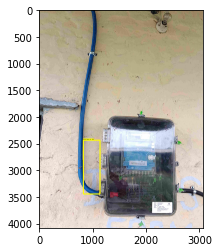

earthing disconnected
Image Filename: 002029337529.jpg


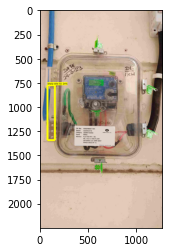

earthing disconnected
Image Filename: 002030507791.jpg


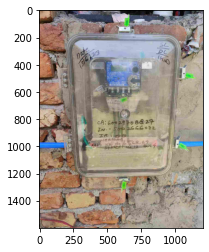

earthing disconnected
Image Filename: 002030615442.jpg


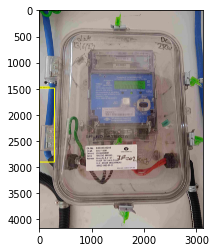

earthing disconnected
Image Filename: 002031998644.jpg


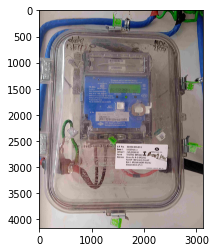

earthing disconnected
Image Filename: 002031998836.jpg


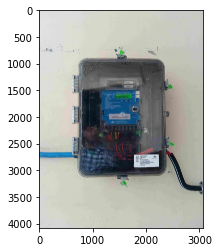

earthing disconnected
Image Filename: 002032055896.jpg


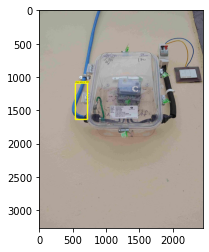

earthing disconnected
Image Filename: 002032178965.jpg


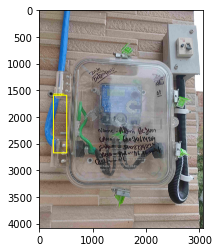

earthing disconnected
Image Filename: 002032537483.jpg


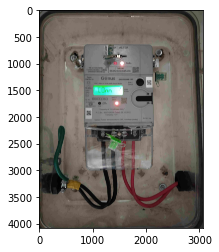

earthing disconnected
Image Filename: 002032564089.jpg


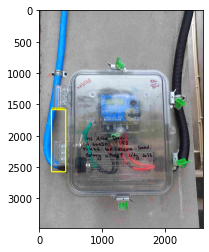

earthing disconnected
Image Filename: 002032605683.jpg


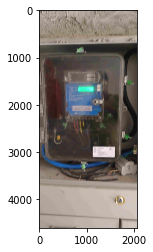

earthing disconnected
Image Filename: 002032605824.jpg


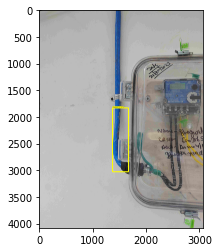

earthing disconnected
Image Filename: 002032612844.jpg


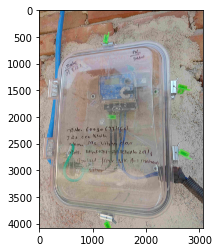

earthing disconnected
Image Filename: 002032630084.jpg


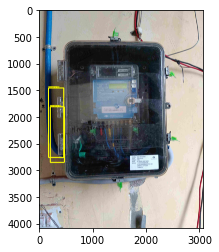

earthing disconnected
Image Filename: 002032684525.jpg


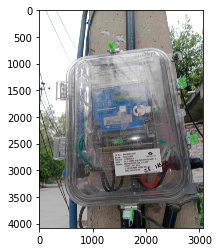

earthing disconnected
Image Filename: 002032812298.jpg


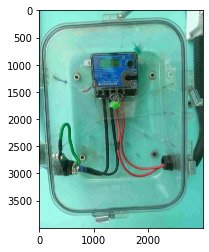

earthing disconnected
Image Filename: 002032858584.jpg


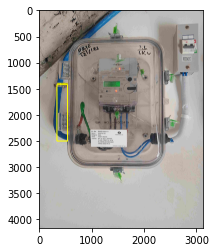

earthing disconnected
Image Filename: 002032953497.jpg


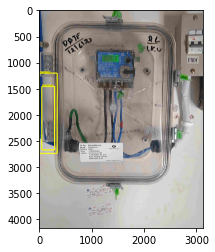

earthing disconnected
Image Filename: 002032953576.jpg


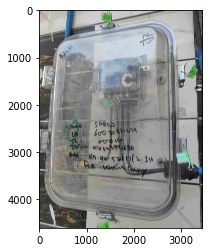

earthing disconnected
Image Filename: 002032993292.jpg


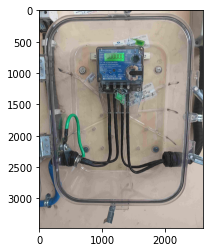

earthing disconnected
Image Filename: 002033035436.jpg


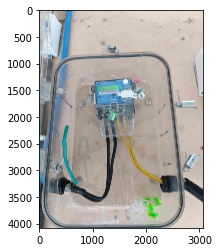

earthing disconnected
Image Filename: 002033035832.jpg


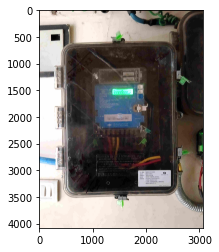

earthing disconnected
Image Filename: 002033037863.jpg


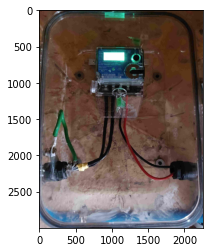

earthing disconnected
Image Filename: 002033046555.jpg


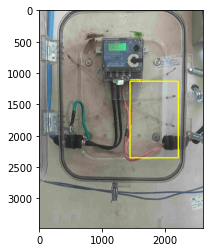

earthing disconnected
Image Filename: 002033069144.jpg


KeyboardInterrupt: 

In [30]:
# Path to the folder containing the train images
train_folder = r"D:\Akshat jain\tpddl\TFODCourse\Tensorflow\workspace\images\testing"

# Iterate over each image file in the train folder
for filename in os.listdir(train_folder):
    if filename.endswith(".jpg") or filename.endswith(".jpeg"):
        image_path = os.path.join(train_folder, filename)

        # Load and preprocess the image
        img = cv2.imread(image_path)
        image_np = np.array(img)
        input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)

        # Perform object detection on the image
        detections = detect_fn(input_tensor)
        num_detections = int(detections.pop('num_detections'))
        detections = {key: value[0, :num_detections].numpy() for key, value in detections.items()}
        detections['num_detections'] = num_detections
        detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

        label_id_offset = 1  # Update label_id_offset to 1
        image_np_with_detections = image_np.copy()

        # Visualize the detections on the image
        viz_utils.visualize_boxes_and_labels_on_image_array(
            image_np_with_detections,
            detections['detection_boxes'],
            detections['detection_classes'] + label_id_offset,
            detections['detection_scores'],
            category_index,
            use_normalized_coordinates=True,
            max_boxes_to_draw=5,
            min_score_thresh=.2,
            line_thickness=20,
            agnostic_mode=False)

        # Display the image with detections
        plt.imshow(cv2.cvtColor(image_np_with_detections, cv2.COLOR_BGR2RGB))
        plt.show()

        # Check if the sharp wire is detected
        sharp_wire_detected = False
        sharp_wire_label = '1'  # Replace with the correct label for sharp wire

        for class_id in detections['detection_classes']:
            if class_id + label_id_offset in category_index:
                class_name = category_index[class_id + label_id_offset]['name']
                if class_name == sharp_wire_label:
                    sharp_wire_detected = True
                    break

        # Print the sharp wire detection result
        if sharp_wire_detected:
            print("earthing connected")
        else:
            print("earthing disconnected")

        # Print the filename
        print("Image Filename:", filename)


In [26]:
def detect(img):
    image_np = np.array(img)

    input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)
    detections = detect_fn(input_tensor)

    num_detections = int(detections.pop('num_detections'))
    detections = {key: value[0, :num_detections].numpy()
                  for key, value in detections.items()}
    detections['num_detections'] = num_detections

    # detection_classes should be ints.
    detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

    label_id_offset = 1
    image_np_with_detections = image_np.copy()

    viz_utils.visualize_boxes_and_labels_on_image_array(
                image_np_with_detections,
                detections['detection_boxes'],
                detections['detection_classes']+label_id_offset,
                detections['detection_scores'],
                category_index,
                use_normalized_coordinates=True,
                max_boxes_to_draw=6,
                min_score_thresh=.2,
                agnostic_mode=False)
    plt.imshow(cv2.cvtColor(image_np_with_detections, cv2.COLOR_BGR2RGB))
    plt.show()
    boxes = detections['detection_boxes']
    # get all boxes from an array
    max_boxes_to_draw = boxes.shape[0]
    # get scores to get a threshold
    scores = detections['detection_scores']
    # this is set as a default but feel free to adjust it to your needs
    result=[]
    min_score_thresh=.2
    
    # iterate over all objects found
    for i in range(min(max_boxes_to_draw, boxes.shape[0])):
        if scores is None or scores[i] > min_score_thresh:
            # boxes[i] is the box which will be drawn
            class_name = category_index[detections['detection_classes'][i]+1]['name']
            result.append((boxes[i][1], class_name))
    
    text = ''
    sharp_wire_detected = False
    
    for box, class_name in sorted(result):
        if class_name == 'seal' or class_name == 'no seal':
            sharp_wire_detected = True
            if class_name == 'seal':
                text += 'seal'
            elif class_name == 'no seal':
                text += 'no seal'
            break
    
    

    return text


In [27]:
count = 0

In [28]:
MeterReading = []
InstallationNumber = []

In [13]:

def detect(img):
    image_np = np.array(img)

    input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)
    detections = detect_fn(input_tensor)

    num_detections = int(detections.pop('num_detections'))
    detections = {key: value[0, :num_detections].numpy()
                  for key, value in detections.items()}
    detections['num_detections'] = num_detections

    # detection_classes should be ints.
    detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

    label_id_offset = 1
    image_np_with_detections = image_np.copy()

    viz_utils.visualize_boxes_and_labels_on_image_array(
                image_np_with_detections,
                detections['detection_boxes'],
                detections['detection_classes']+label_id_offset,
                detections['detection_scores'],
                category_index,
                use_normalized_coordinates=True,
                max_boxes_to_draw=6,
                min_score_thresh=.2,
                agnostic_mode=False)
    plt.imshow(cv2.cvtColor(image_np_with_detections, cv2.COLOR_BGR2RGB))
    plt.show()
    boxes = detections['detection_boxes']
    # get all boxes from an array
    max_boxes_to_draw = boxes.shape[0]
    # get scores to get a threshold
    scores = detections['detection_scores']
    # this is set as a default but feel free to adjust it to your needs
    result=[]
    min_score_thresh=.2
    
    # iterate over all objects found
    for i in range(min(max_boxes_to_draw, boxes.shape[0])):
        #
        if scores is None or scores[i] > min_score_thresh:
            # boxes[i] is the box which will be drawn
            class_name = category_index[detections['detection_classes'][i]+1]['name']
            result.append((boxes[i][1],detections['detection_classes'][i]))
    text=''
    result2 = []
    for x in result:
        if x[0] not in [i[0] for i in result2]:
            result2.append(x)
#     print(result2)

    for i in sorted(result2):
        if int(i[1])==10:
            text+='.'
        else:
            text+=str(i[1])
#     print("Predicted Reading: 12950")
    return text

In [14]:
count = 0

In [15]:
MeterReading = []
InstallationNumber = []

Processing image 1/370


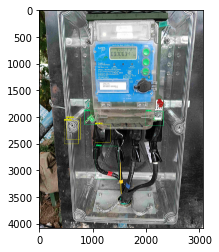

no seal


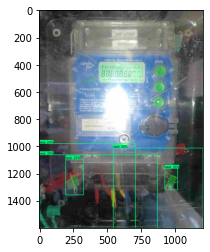

seal


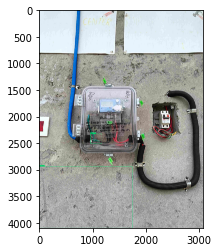

seal


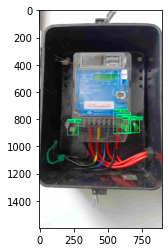

seal


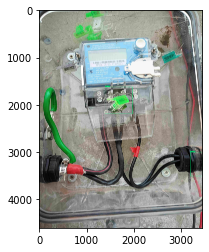

seal


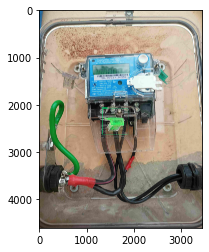

seal


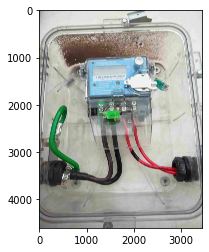

seal


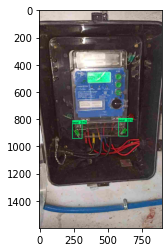

seal


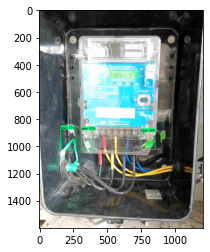

seal


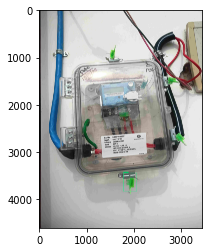

seal


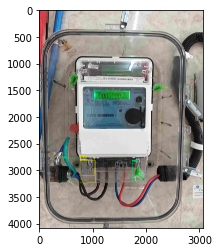

seal


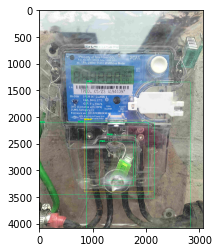

seal


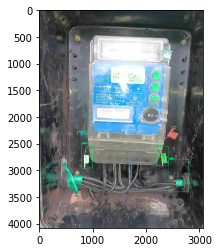

seal


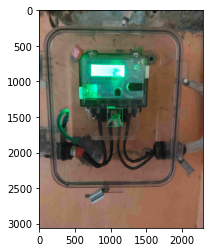

seal


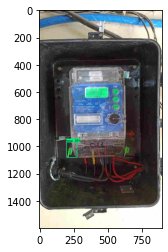

seal


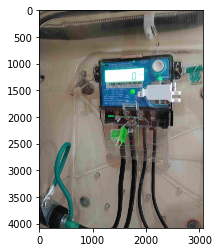

seal


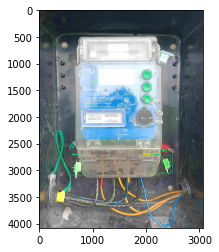

seal


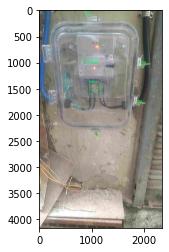

seal


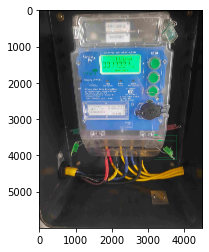

seal


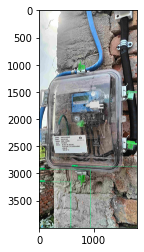

seal


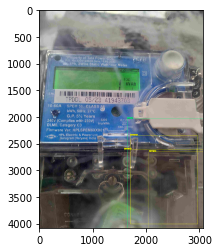

no seal


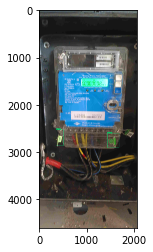

seal


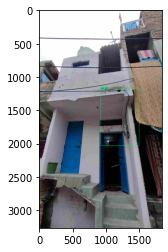

seal


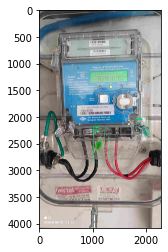

seal


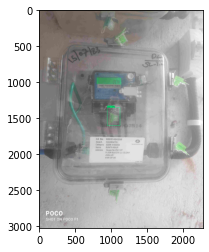

seal


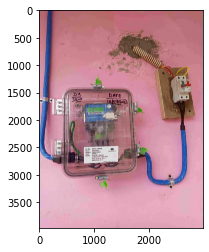

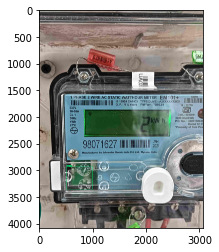

seal


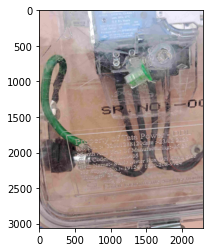

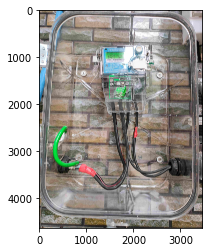

seal


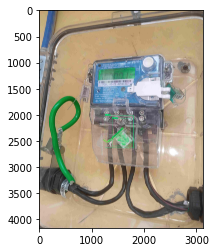

seal


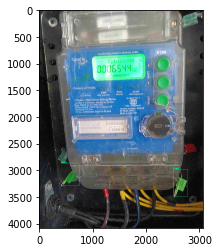

seal


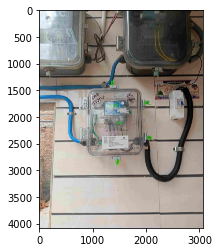

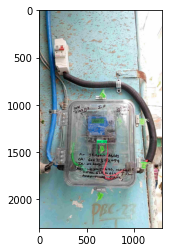

seal


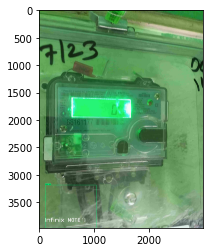

seal


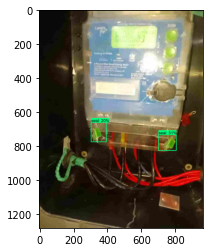

seal


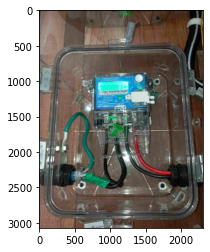

seal


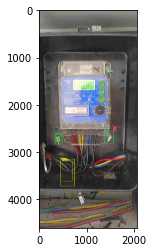

seal


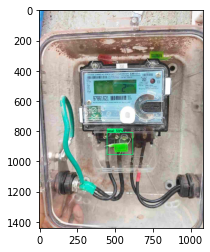

seal


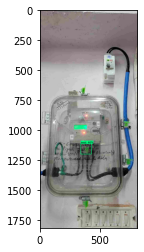

seal


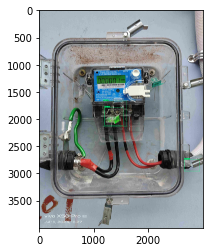

seal


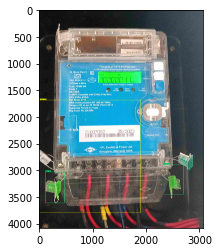

no seal


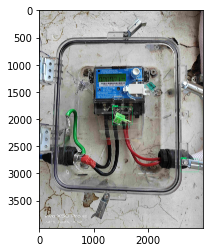

seal


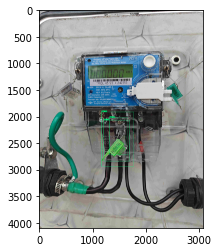

seal


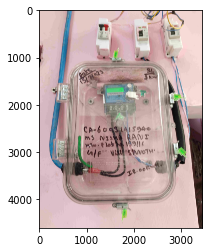

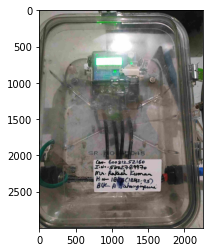

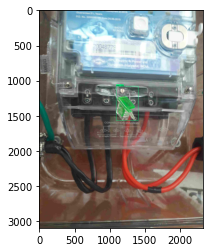

seal


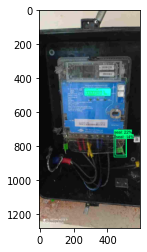

seal


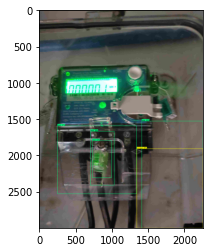

seal


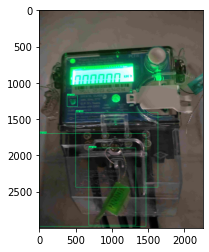

seal


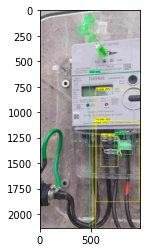

no seal


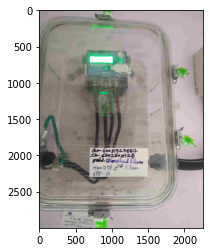

seal


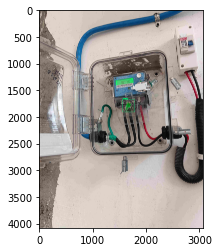

seal


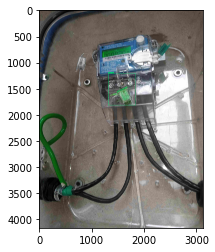

seal


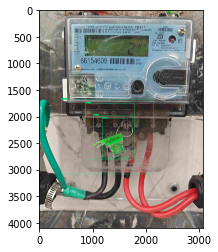

seal


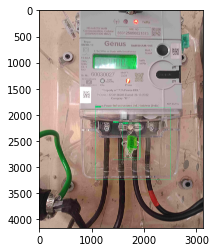

seal


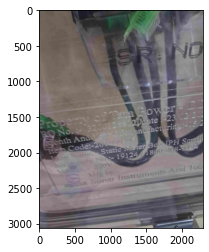

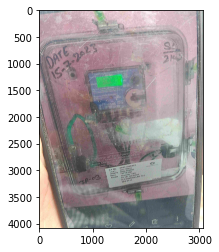

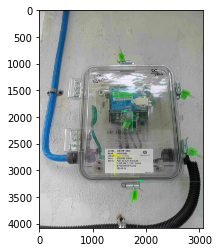

no seal


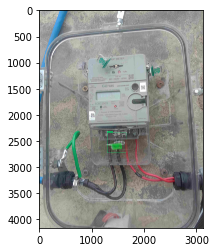

seal


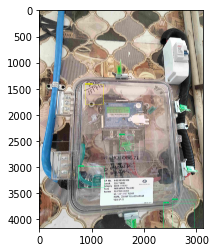

seal


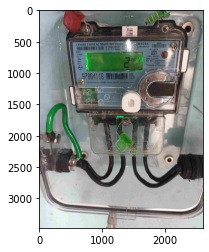

seal


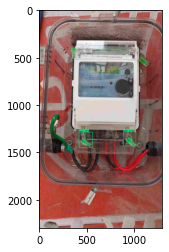

seal


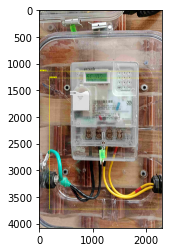

no seal


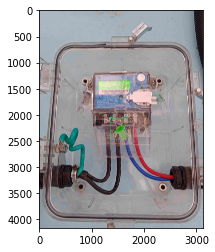

seal


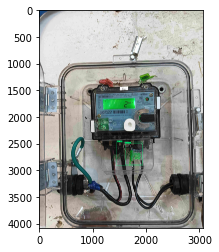

seal


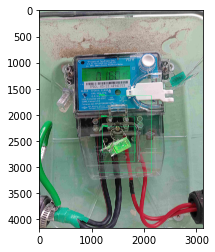

seal


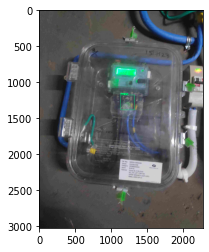

seal


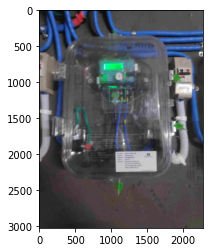

seal


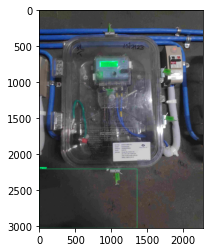

seal


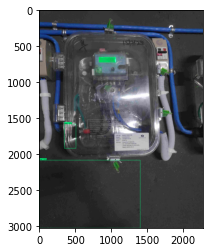

seal


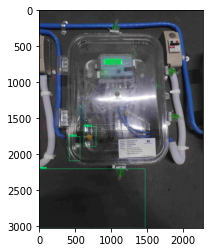

seal


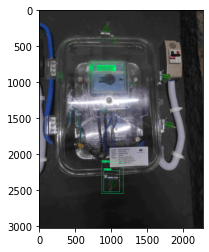

seal


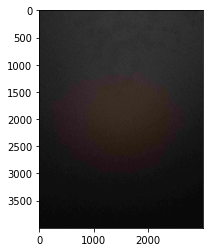

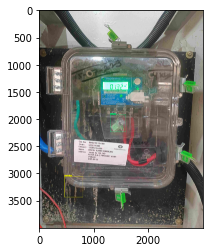

no seal


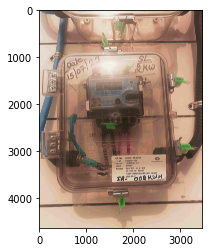

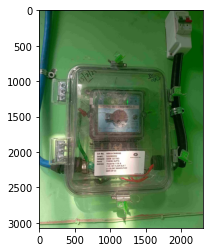

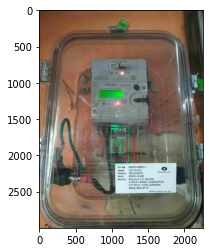

seal


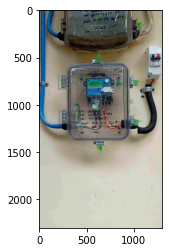

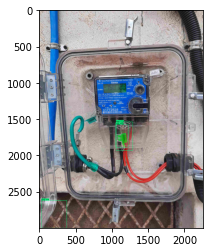

seal


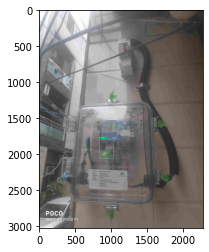

seal


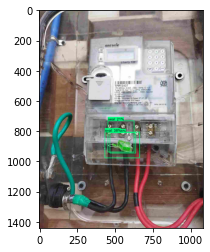

seal


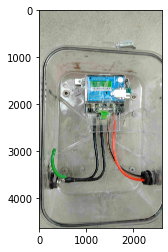

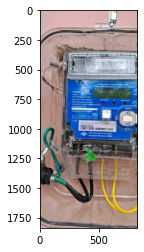

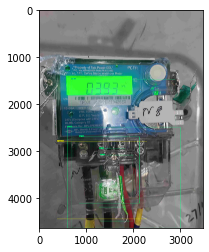

no seal


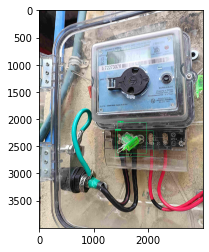

seal


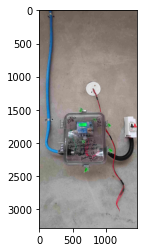

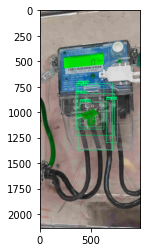

seal


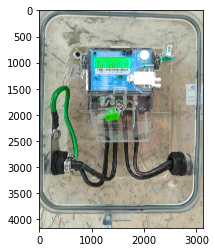

seal


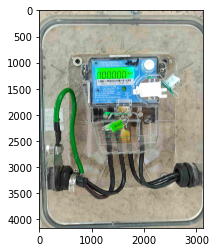

seal


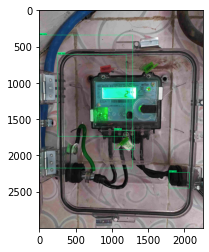

seal


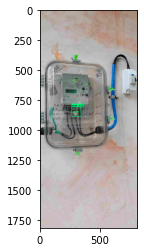

seal


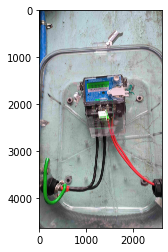

seal


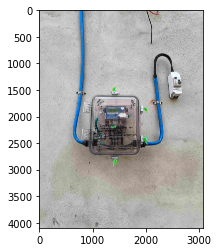

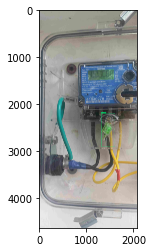

seal


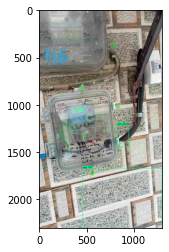

seal


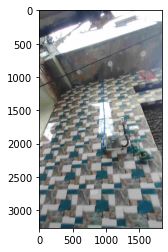

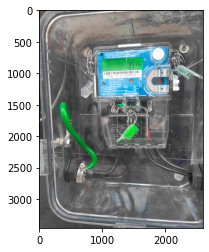

seal


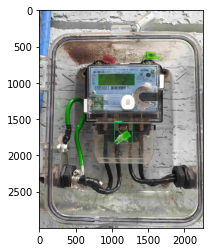

seal


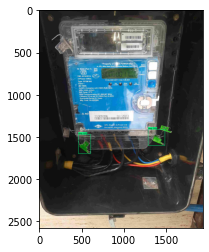

seal


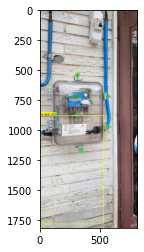

no seal
Processing image 100/370
Predicted: no seal
Actual: 002034430758.jpg


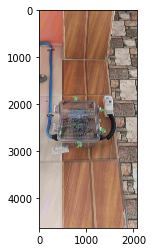

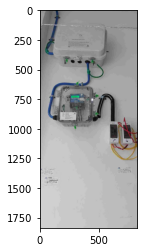

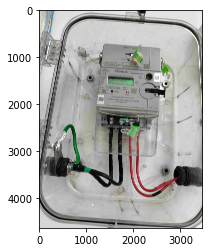

seal


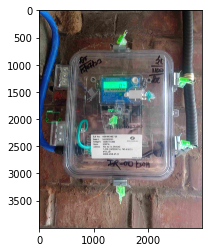

seal


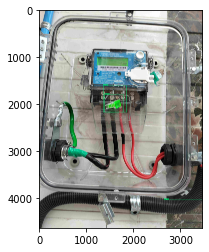

seal


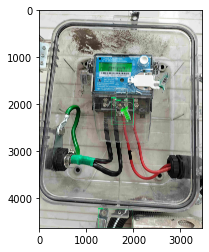

seal


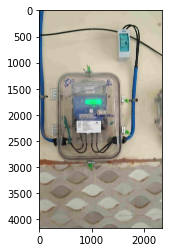

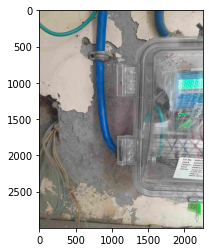

seal


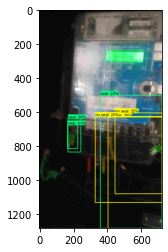

seal


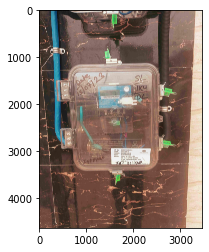

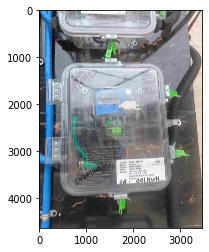

seal


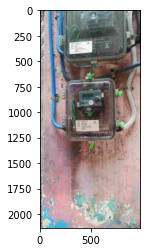

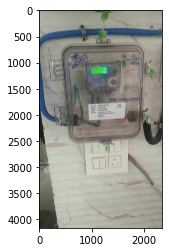

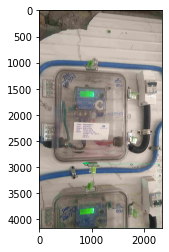

seal


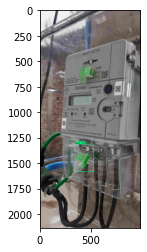

seal


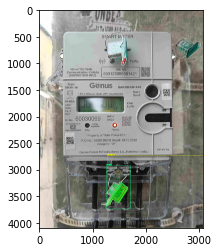

seal


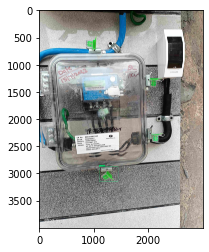

seal


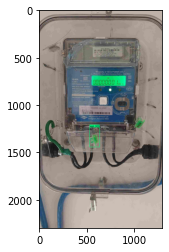

seal


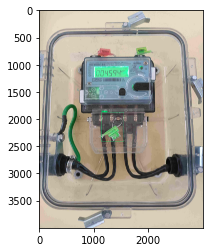

seal


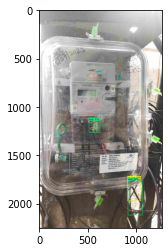

seal


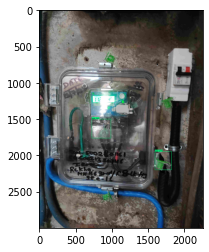

seal


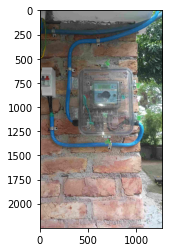

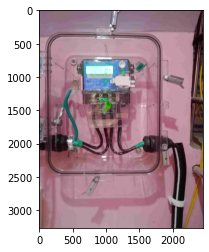

seal


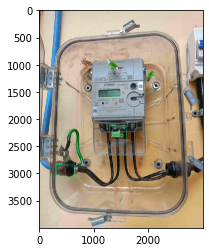

seal


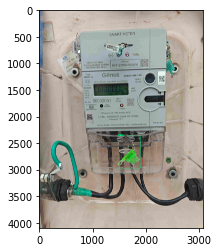

seal


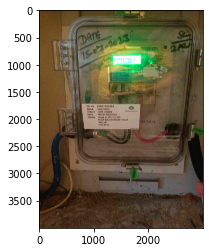

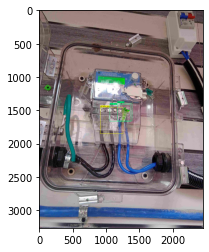

no seal


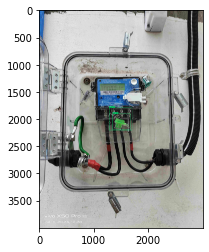

seal


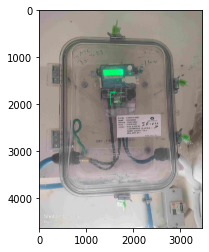

seal


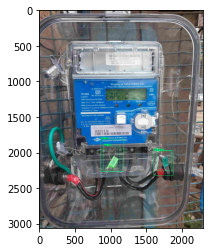

seal


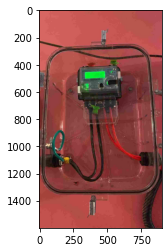

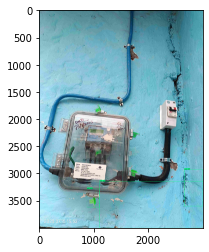

seal


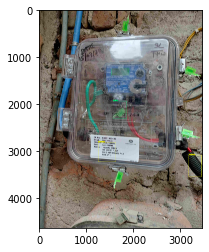

no seal


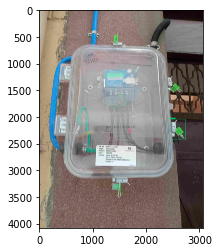

seal


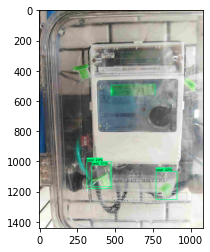

seal


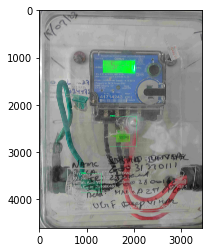

seal


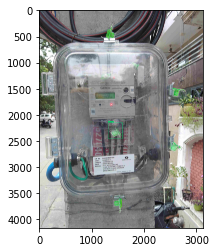

seal


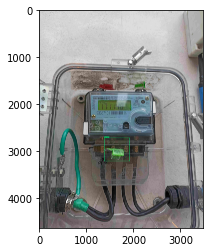

seal


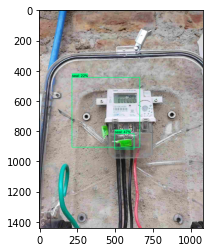

seal


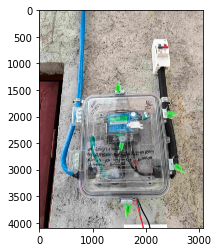

seal


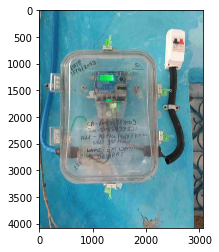

seal


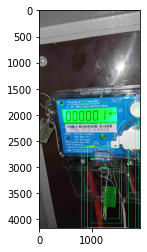

no seal


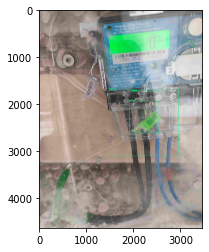

seal


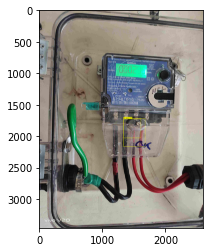

no seal


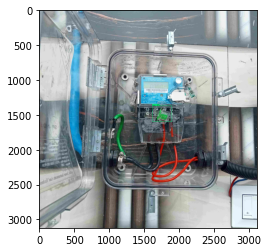

seal


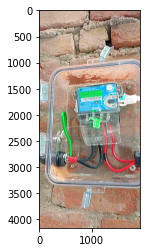

seal


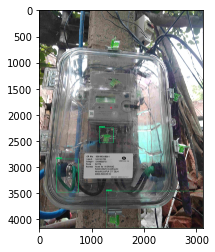

seal


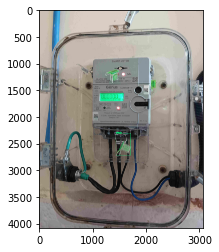

seal


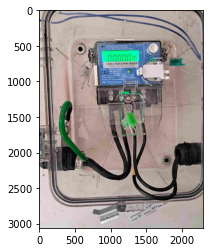

seal


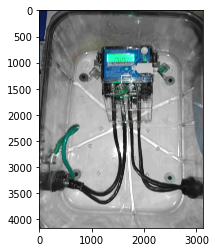

seal


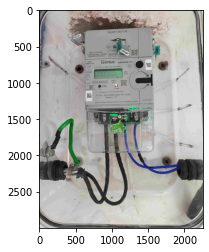

seal


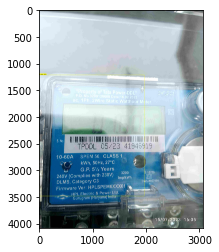

no seal


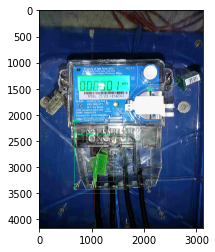

seal


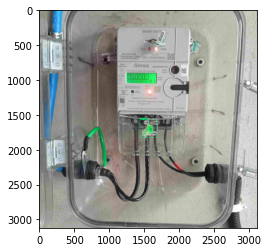

seal


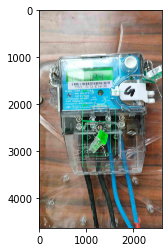

seal


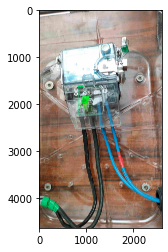

seal


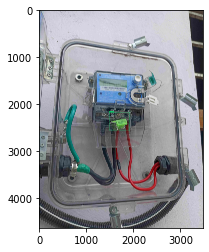

seal


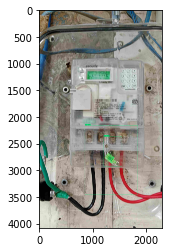

seal


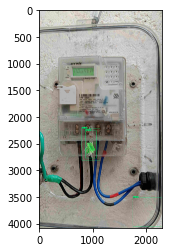

seal


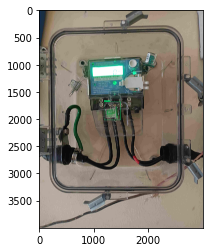

seal


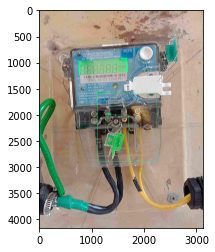

seal


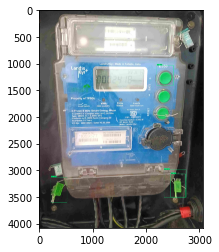

seal


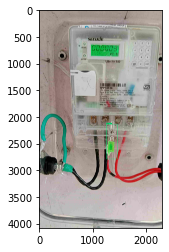

seal


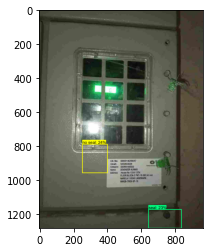

no seal


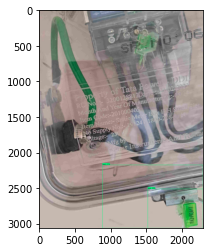

seal


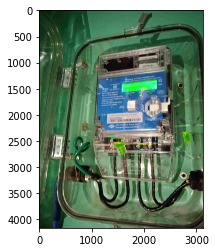

seal


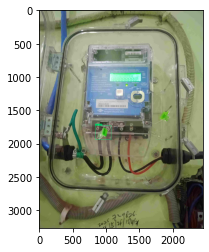

seal


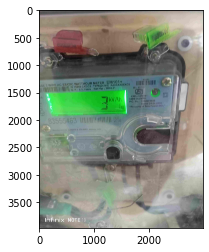

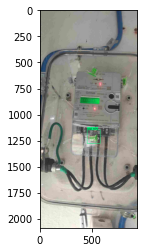

seal


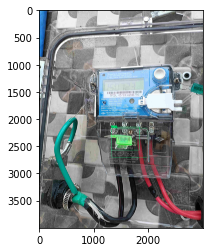

seal


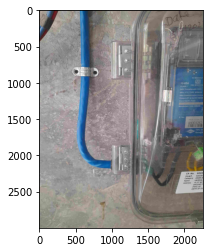

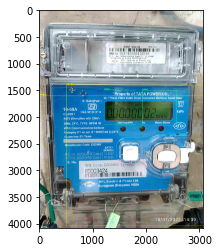

no seal


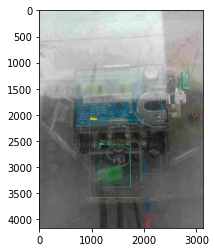

no seal


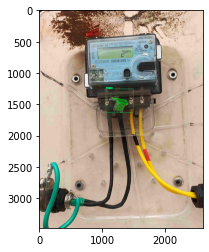

seal


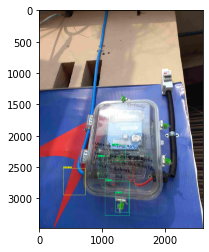

no seal


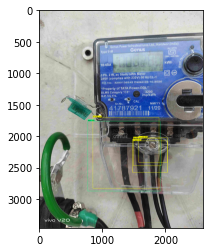

seal


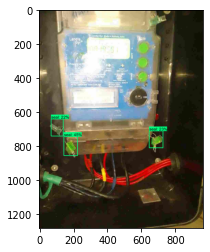

seal


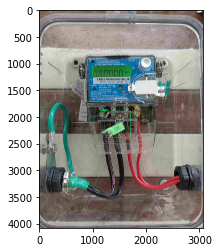

seal


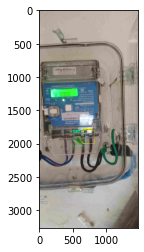

seal


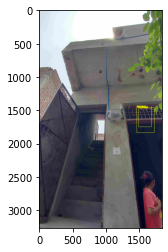

no seal


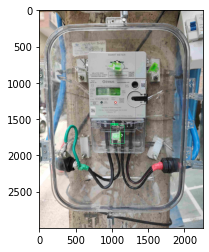

seal


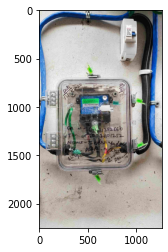

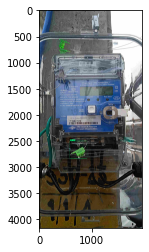

seal


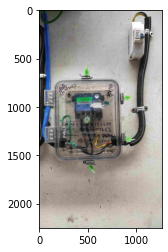

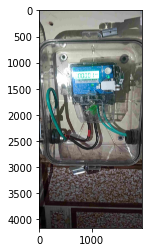

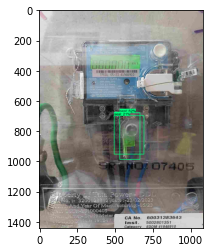

seal


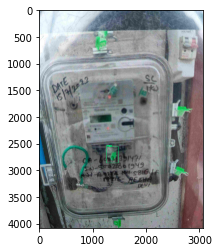

seal


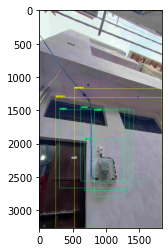

no seal


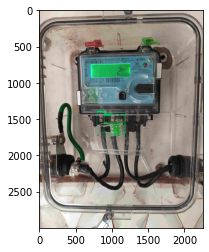

seal


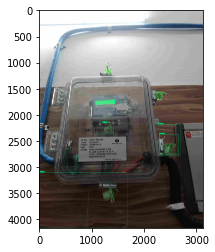

seal


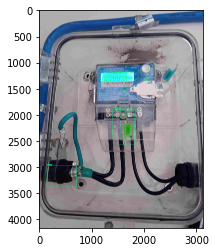

seal


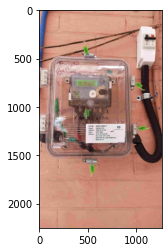

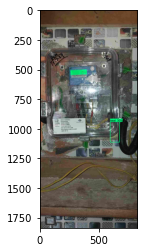

seal


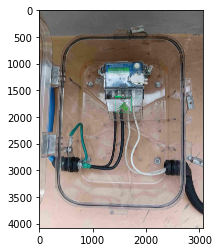

seal


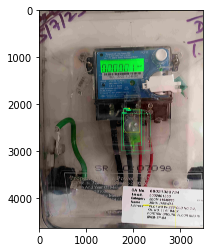

seal


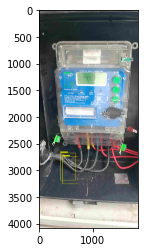

no seal


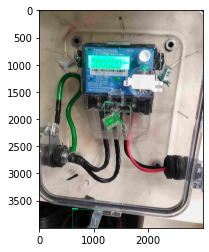

seal


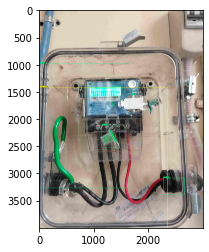

no seal


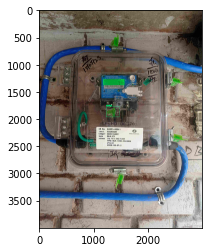

seal


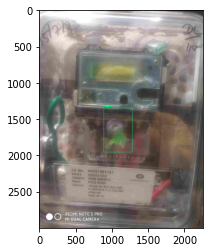

seal
Processing image 200/370
Predicted: seal
Actual: 002034530211.jpg


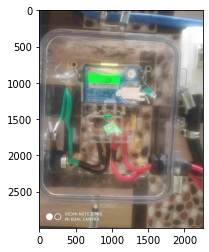

seal


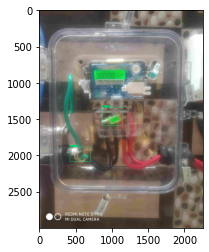

seal


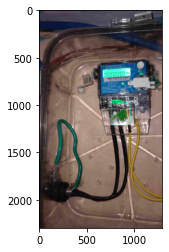

seal


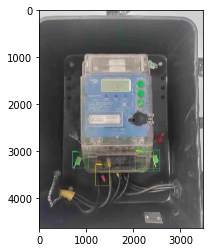

seal


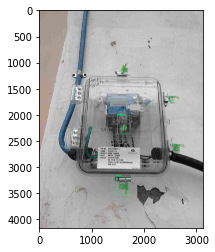

seal


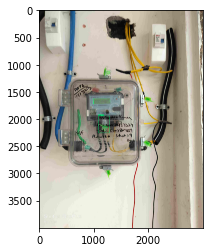

seal


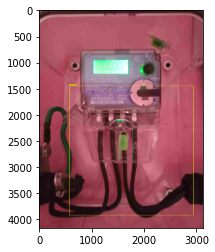

no seal


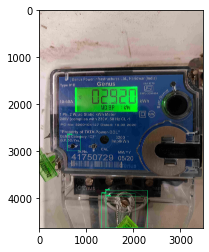

seal


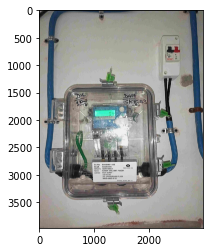

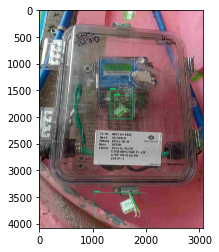

seal


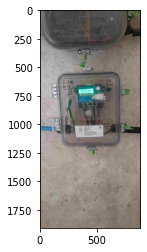

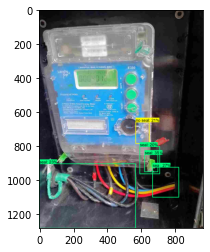

seal


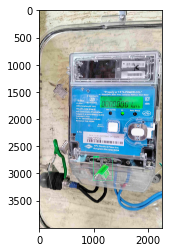

seal


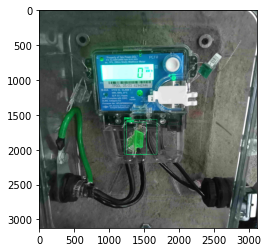

seal


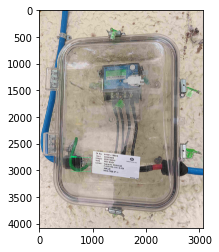

seal


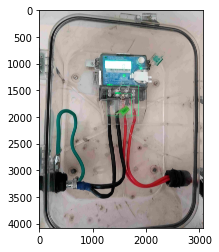

seal


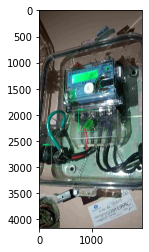

seal


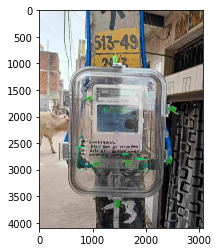

seal


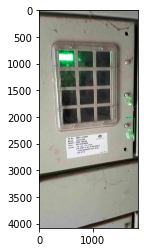

seal


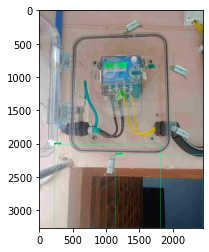

seal


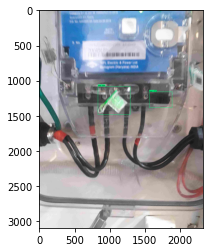

seal


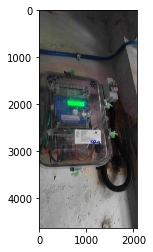

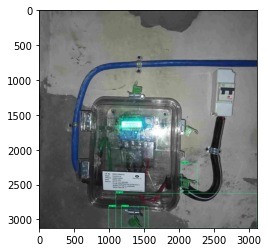

seal


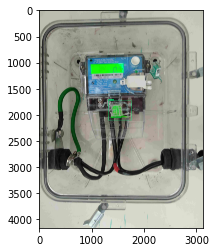

seal


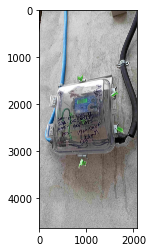

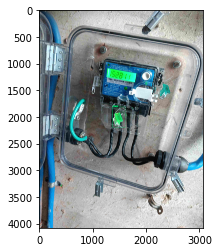

seal


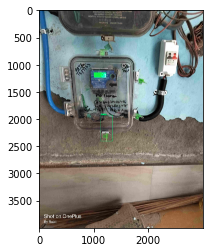

seal


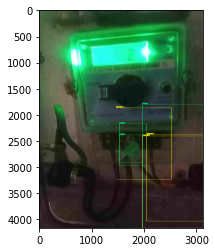

seal


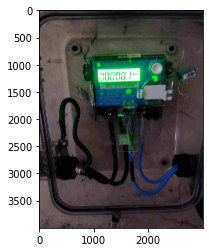

seal


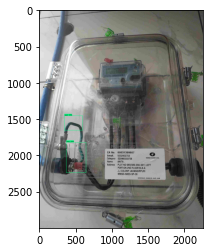

seal


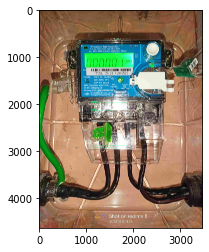

seal


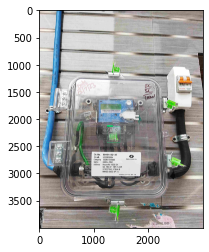

seal


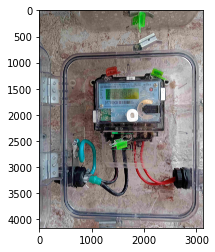

seal


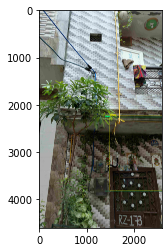

seal


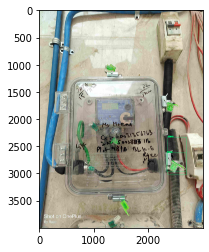

seal


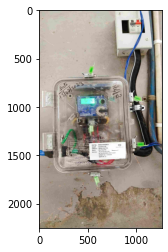

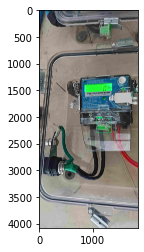

seal


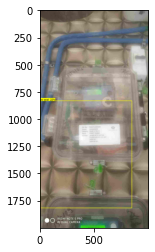

no seal


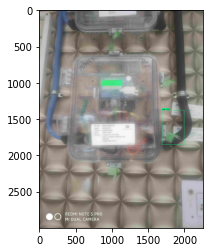

seal


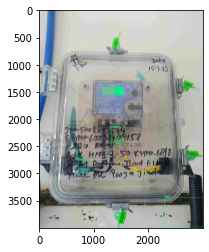

seal


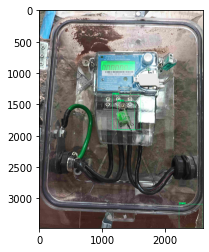

seal


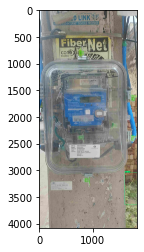

seal


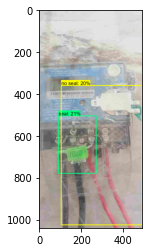

seal


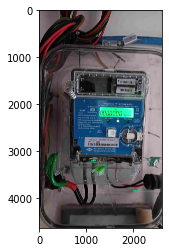

seal


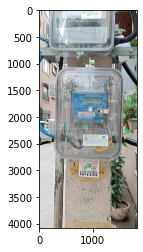

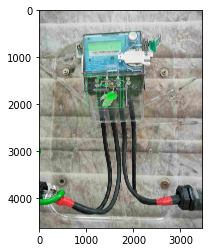

seal


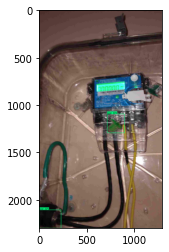

seal


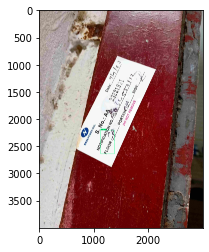

seal


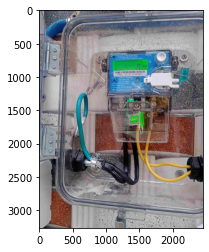

seal


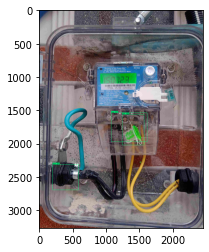

seal


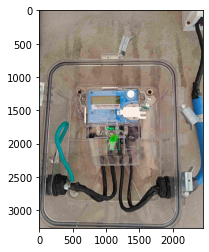

seal


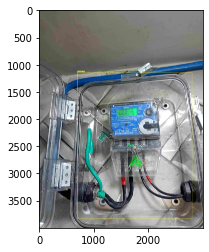

no seal


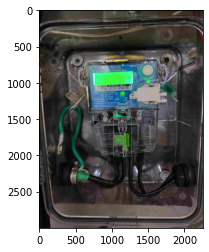

seal


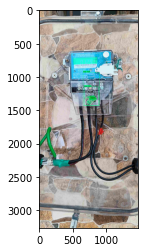

seal


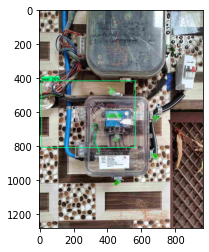

seal


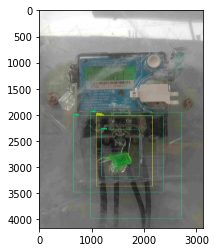

seal


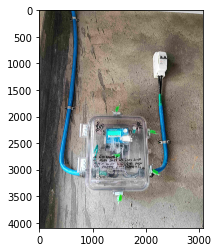

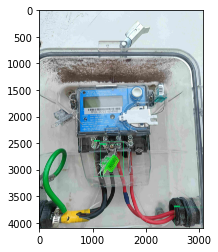

seal


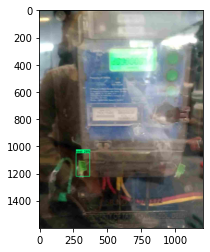

seal


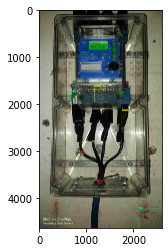

seal


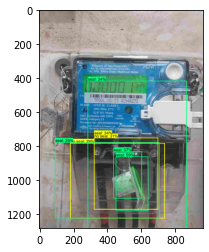

seal


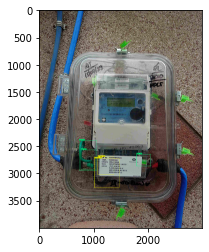

seal


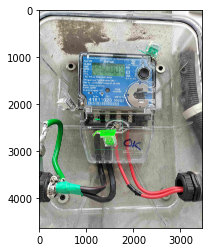

seal


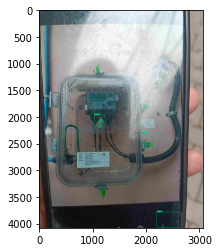

seal


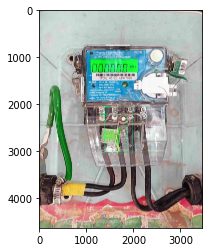

seal


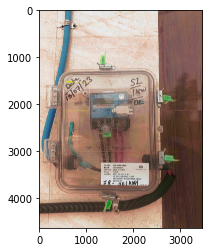

no seal


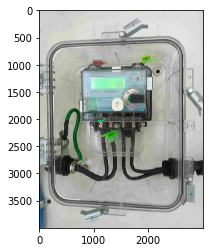

seal


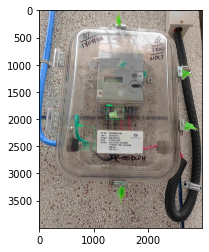

seal


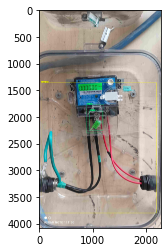

no seal


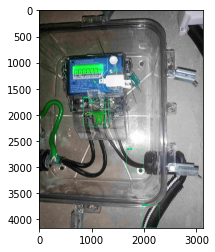

seal


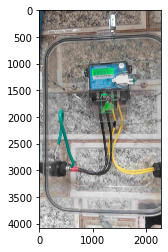

seal


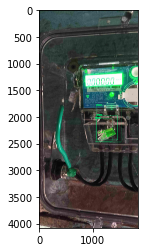

seal


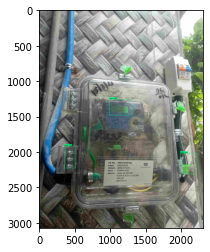

seal


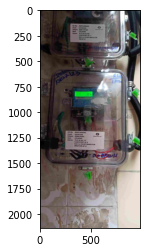

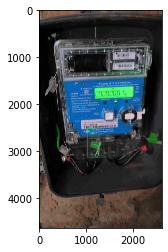

seal


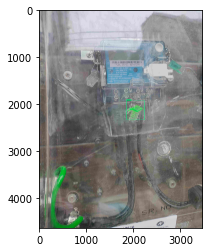

seal


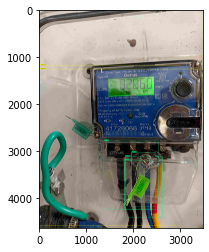

no seal


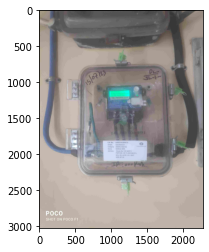

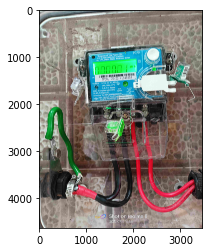

seal


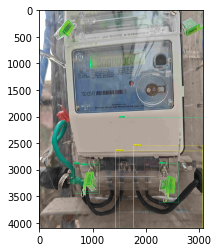

seal


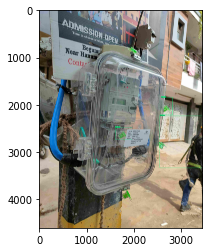

seal


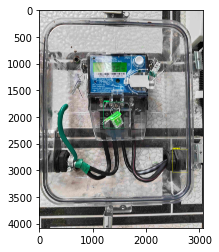

seal


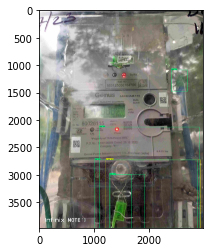

seal


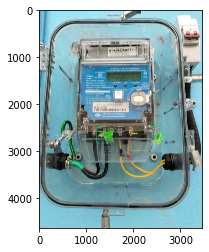

seal


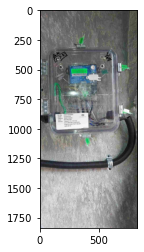

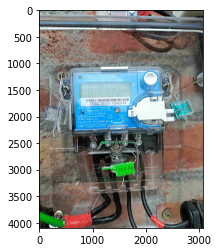

seal


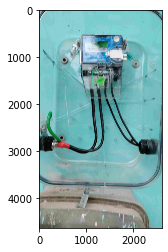

seal


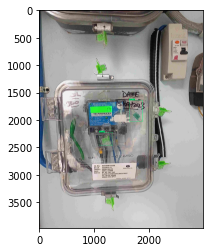

seal


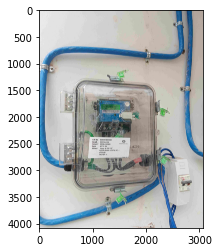

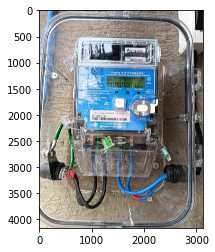

seal


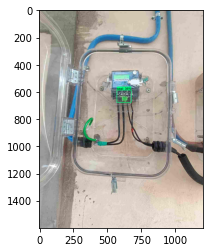

seal


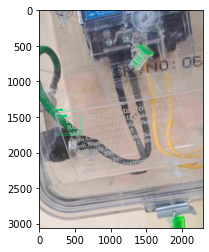

seal


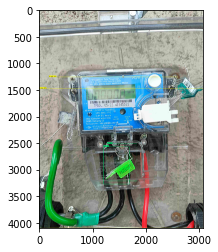

no seal


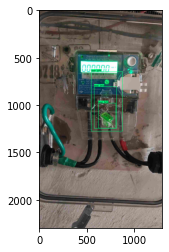

seal


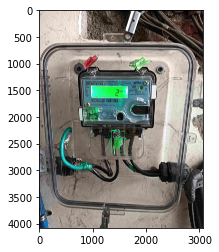

seal


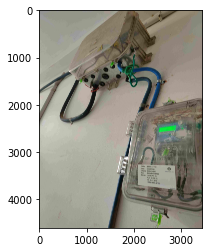

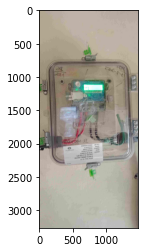

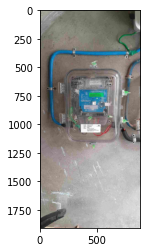

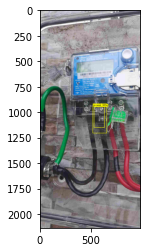

no seal


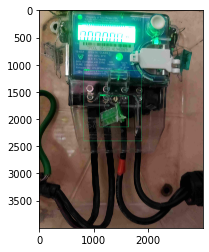

seal
Processing image 300/370
Predicted: seal
Actual: 002034576138.jpg


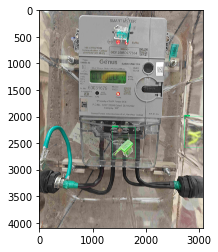

seal


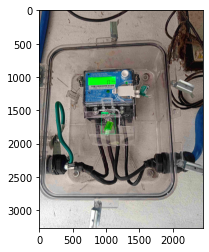

seal


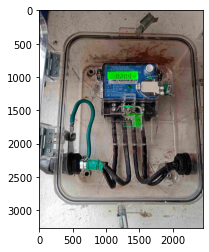

seal


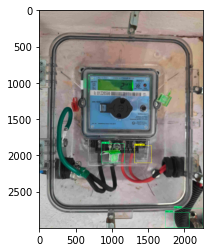

seal


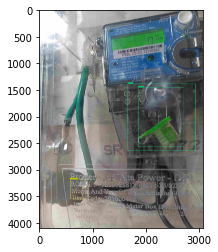

no seal


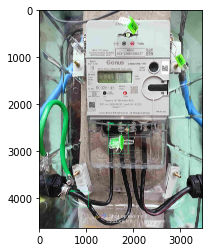

seal


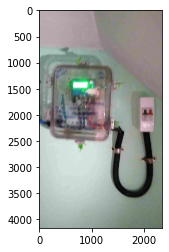

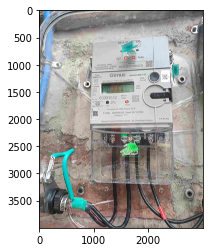

seal


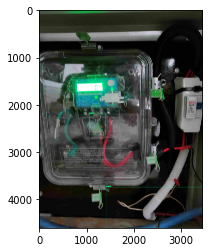

seal


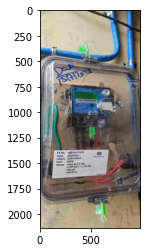

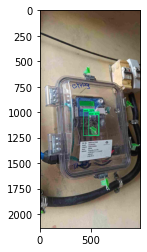

seal


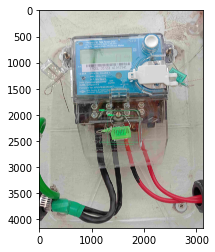

seal


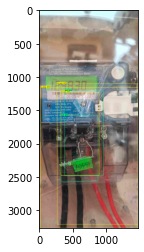

no seal


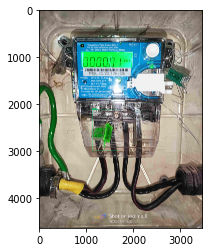

seal


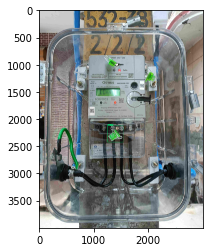

seal


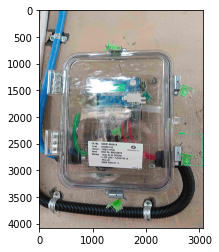

seal


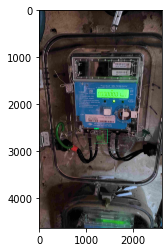

seal


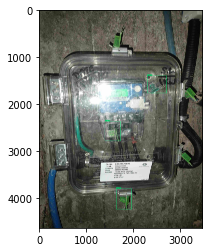

seal


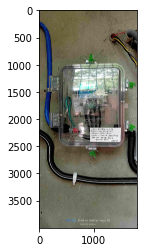

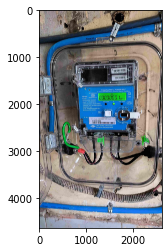

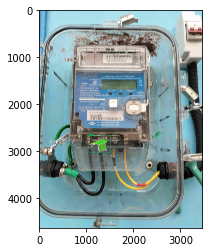

seal


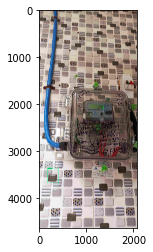

seal


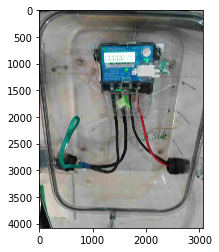

seal


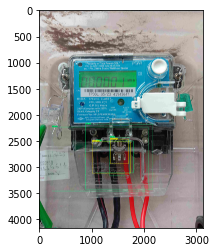

seal


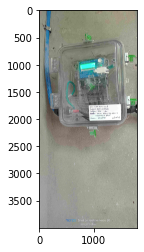

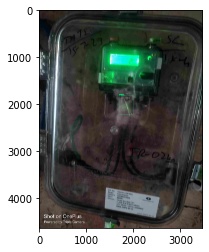

seal


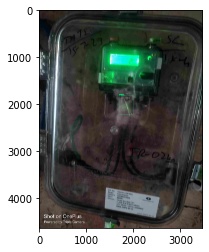

seal


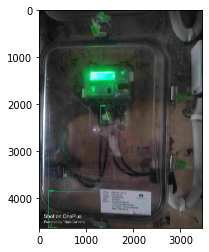

seal


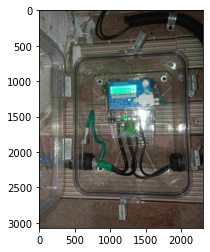

seal


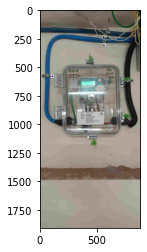

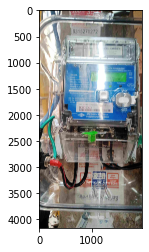

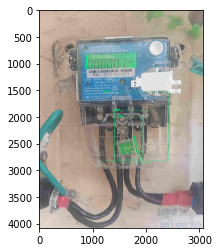

seal


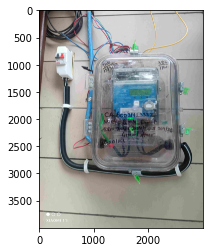

seal


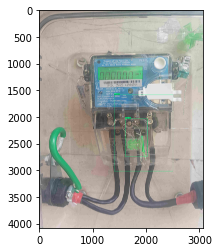

seal


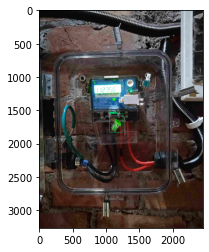

seal


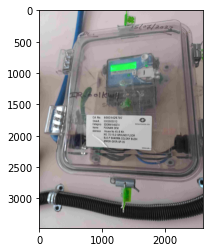

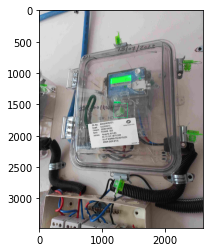

seal


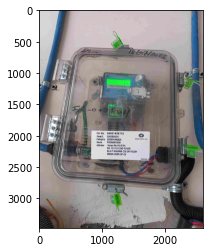

seal


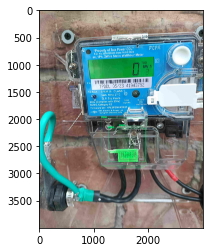

seal


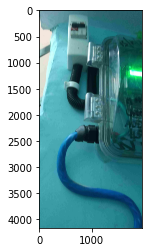

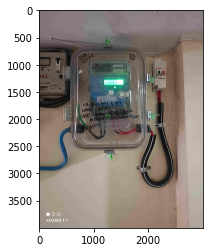

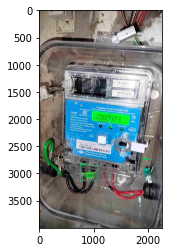

seal


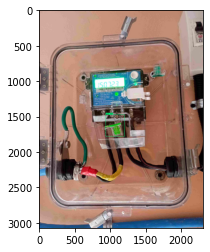

seal


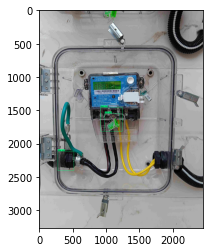

seal


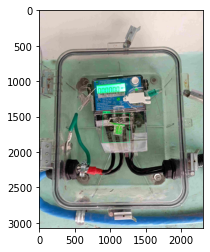

seal


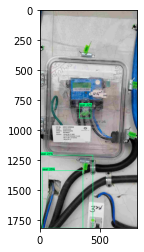

seal


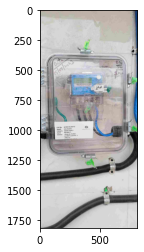

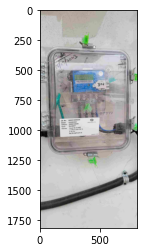

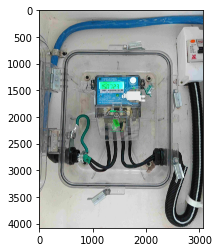

seal


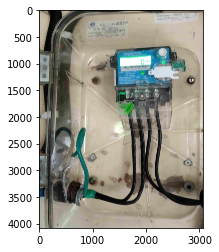

seal


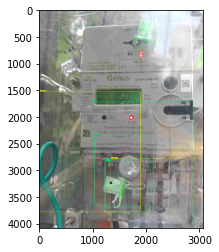

no seal


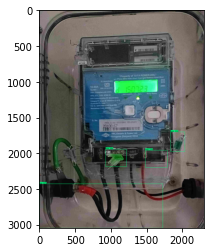

seal


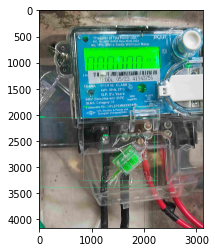

seal


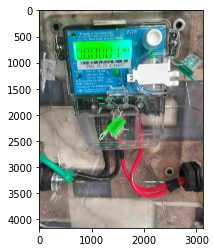

seal


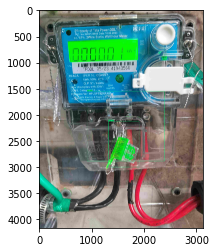

seal


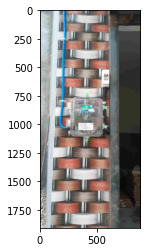

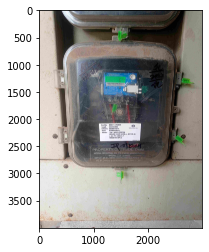

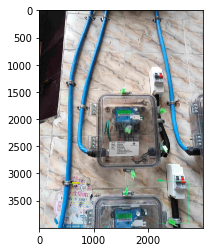

no seal


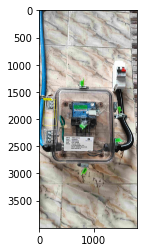

no seal


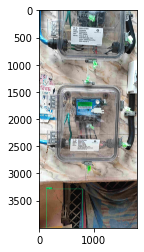

seal


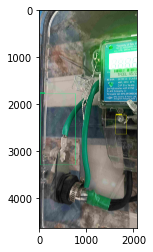

seal


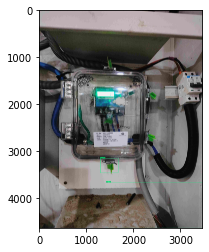

seal


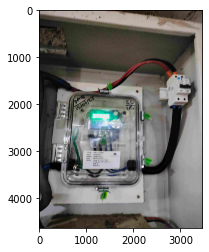

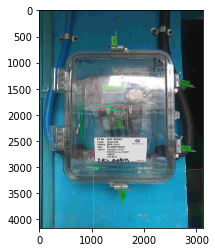

seal


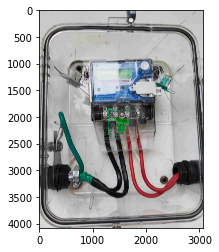

seal


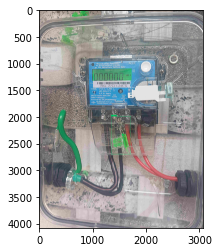

seal


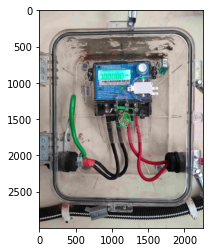

seal


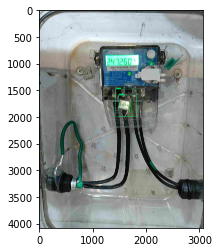

seal


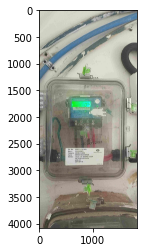

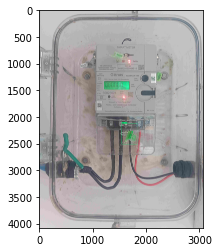

seal
Predicted values saved to D:\Akshat jain\tpddl\TFODCourse\Tensorflow\workspace\images\predicted_values.txt


In [29]:
# Assume the `detect` function is defined and imported already.

directory = r"D:\Akshat jain\tpddl\TFODCourse\Tensorflow\workspace\images\test"

# Check if the output file already exists
output_file_path = r'D:\Akshat jain\tpddl\TFODCourse\Tensorflow\workspace\images\predicted_values.txt'  # Replace with the desired output file path
if os.path.exists(output_file_path):
    # Read the existing predicted values from the file
    with open(output_file_path, 'r') as file:
        existing_values = file.read().splitlines()
    start_index = len(existing_values)
    print(f"Resuming from image {start_index + 1}/{len(os.listdir(directory))}")
else:
    start_index = 0
    print(f"Processing image 1/{len(os.listdir(directory))}")

with open(output_file_path, 'a') as file:  # Open the file in append mode
    for index, filename in enumerate(os.listdir(directory), start=1):
        if index <= start_index:
            continue  # Skip the images that were already processed

        image_path = os.path.join(directory, filename)
        img = cv2.imread(image_path)
        text = detect(img)
        # text = text.lstrip('0')
        print(text)
        if index%100==0:
            print(f"Processing image {index}/{len(os.listdir(directory))}")
            print("Predicted: " + text)
            print("Actual: " + filename)

        file.write(str(text) + '\n')  # Append the predicted value to the file

print(f"Predicted values saved to {output_file_path}")


In [ ]:
directory = r"D:\Akshat jain\tpddl\TFODCourse\Tensorflow\workspace\images\final"


for index, filename in enumerate(os.listdir(directory), start=1):
    image_path = os.path.join(directory, filename)
    img = cv2.imread(image_path)
    text = detect(img)
    #text = text.lstrip('0')

    print(f"Processing image {index}/{len(os.listdir(directory))}")
    print("Predicted: " + text)
    print("Actual: " + filename)

    MeterReading.append(text)
    InstallationNumber.append(filename)

# Save predicted values to a text file
output_file_path = r'D:\Akshat jain\tpddl\TFODCourse\Tensorflow\workspace\images\predicted_values.txt'  # Replace with the desired output file path

with open(output_file_path, 'w') as file:
    for value in MeterReading:
        file.write(str(value) + '\n')

print(f"Predicted values saved to {output_file_path}")


In [58]:
import pandas as pd
# Load the existing Excel file
excel_file_path = r'D:\Akshat jain\tpddl\TFODCourse\Tensorflow\workspace\images\rename.xlsx'
df = pd.read_excel(excel_file_path)

# Read the predicted values from a text file
predicted_values_file_path = r'D:\Akshat jain\tpddl\TFODCourse\Tensorflow\workspace\images\predicted_values.txt'  # Update with the actual file path
with open(predicted_values_file_path, 'r') as file:
    predicted_values = [int(line.strip()) for line in file]

# Check if the length of predicted_values matches the number of rows in the DataFrame
if len(predicted_values) == len(df):
    # Add predicted values to the DataFrame
    df['Predicted'] = predicted_values

    # Compare actual and predicted MeterReading values and calculate accuracy
    correct_predictions = 0
    for index, row in df.iterrows():
        actual_number = int(row['Image Name'].split('_')[0].split('.')[0])
        if actual_number == row['Predicted']:
            correct_predictions += 1

    accuracy = (correct_predictions / len(df)) * 100

    # Save the updated DataFrame to the Excel file
    df.to_excel(excel_file_path, index=False)

    print(f"Accuracy: {accuracy:.2f}%")
else:
    print("The length of predicted_values does not match the number of rows in the DataFrame.")


ValueError: invalid literal for int() with base 10: 'sharp wire yes'

In [27]:
# Load the existing Excel file
excel_file_path = r'D:\Akshat jain\tpddl\TFODCourse\Tensorflow\workspace\images\rename_3.xlsx'
df = pd.read_excel(excel_file_path)

# Read the predicted values from a text file
predicted_values_file_path = r'D:\Akshat jain\tpddl\TFODCourse\Tensorflow\workspace\images\predicted_values_2.txt'  # Update with the actual file path
with open(predicted_values_file_path, 'r') as file:
    predicted_values = [int(line.strip()) for line in file]

# Check if the length of predicted_values matches the number of rows in the DataFrame
if len(predicted_values) == len(df):
    # Add predicted values to the DataFrame
    df['Predicted'] = predicted_values

    # Compare actual and predicted image names and calculate accuracy
    incorrect_predictions = []
    for index, row in df.iterrows():
        actual_number = int(row['Image Name'].split('_')[0].split('.')[0])
        if actual_number != row['Predicted']:
            incorrect_predictions.append((row['Image Name'], row['Predicted']))

    accuracy = ((len(df) - len(incorrect_predictions)) / len(df)) * 100

    # Save the updated DataFrame to the Excel file
    df.to_excel(excel_file_path, index=False)

    print(f"Accuracy: {accuracy:.2f}%")
    
    if len(incorrect_predictions) > 0:
        print("Incorrect Predictions:")
        for actual_name, predicted_name in incorrect_predictions:
            print(f"Actual: {actual_name}, Predicted: {predicted_name}")
else:
    print("The length of predicted_values does not match the number of rows in the DataFrame.")


Accuracy: 78.38%
Incorrect Predictions:
Actual: 000000, Predicted: 7
Actual: 00000021, Predicted: 6621
Actual: 000000_4, Predicted: 80000
Actual: 000000_6, Predicted: 1000000
Actual: 000000_8, Predicted: 1
Actual: 000002, Predicted: 1000002
Actual: 000002_1, Predicted: 0
Actual: 0000040, Predicted: 401
Actual: 000006, Predicted: 660
Actual: 0000071, Predicted: 5071
Actual: 00001538, Predicted: 1638
Actual: 0000214, Predicted: 90090902514
Actual: 0000232, Predicted: 239
Actual: 0000260, Predicted: 280
Actual: 000029, Predicted: 800029
Actual: 0000356, Predicted: 68000356
Actual: 00004, Predicted: 80
Actual: 0000411, Predicted: 4117
Actual: 0000482, Predicted: 500005482
Actual: 0000514, Predicted: 54
Actual: 00005223, Predicted: 59231
Actual: 0000543, Predicted: 80543
Actual: 00005808, Predicted: 28808
Actual: 00005871, Predicted: 805871
Actual: 00006249, Predicted: 94006249
Actual: 0000627, Predicted: 8627
Actual: 000070, Predicted: 1000070
Actual: 0000702_1, Predicted: 7052
Actual: 000

In [21]:
# Load the existing Excel file
excel_file_path = r'D:\Akshat jain\tpddl\TFODCourse\Tensorflow\workspace\images\rename.xlsx'
df = pd.read_excel(excel_file_path)

# Read the predicted values from a text file
predicted_values_file_path = r'D:\Akshat jain\tpddl\TFODCourse\Tensorflow\workspace\images\predicted_values_2.txt'  # Update with the actual file path
with open(predicted_values_file_path, 'r') as file:
    predicted_values = [int(line.strip()) for line in file]

# Check if the length of predicted_values matches the number of rows in the DataFrame
if len(predicted_values) == len(df):
    # Add predicted values to the DataFrame
    df['Predicted'] = predicted_values

    # Compare actual and predicted MeterReading values and calculate accuracy
    correct_predictions = 0
    for index, row in df.iterrows():
        if row['Image Name'] == row['Predicted']:
            correct_predictions += 1

    accuracy = (correct_predictions / len(df)) * 100

    # Save the updated DataFrame to the Excel file
    df.to_excel(excel_file_path, index=False)

    print(f"Accuracy: {accuracy:.2f}%")
else:
    print("The length of predicted_values does not match the number of rows in the DataFrame.")


Accuracy: 0.00%


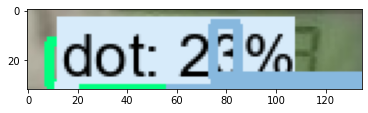

'0.6884'

In [45]:
# Read image
img = cv2.imread(IMAGE_PATH)
image_np = np.array(img)

# Get image size
image_height, image_width, _ = image_np.shape

# Convert image to tensor
input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)
detections = detect_fn(input_tensor)

# Process detections
num_detections = int(detections.pop('num_detections'))
detections = {key: value[0, :num_detections].numpy() for key, value in detections.items()}
detections['num_detections'] = num_detections

# detection_classes should be ints.
detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

label_id_offset = 1
image_np_with_detections = image_np.copy()

# Visualize the detections
viz_utils.visualize_boxes_and_labels_on_image_array(
    image_np_with_detections,
    detections['detection_boxes'],
    detections['detection_classes'] + label_id_offset,
    detections['detection_scores'],
    category_index,
    use_normalized_coordinates=True,
    max_boxes_to_draw=6,
    min_score_thresh=0.2,
    agnostic_mode=False
)

# Display the image
plt.imshow(cv2.cvtColor(image_np_with_detections, cv2.COLOR_BGR2RGB))
plt.show()

# Extract detected objects and their classes
boxes = detections['detection_boxes']
# Get all boxes from an array
max_boxes_to_draw = boxes.shape[0]
# Get scores to define a threshold
scores = detections['detection_scores']
# Set a default threshold
min_score_thresh = 0.2
result = []

# Iterate over all objects found
for i in range(min(max_boxes_to_draw, boxes.shape[0])):
    if scores is None or scores[i] > min_score_thresh:
        # Define category index mapping
        zero = 10
        dot = 11  # Get the ASCII value of '.'

        category_index_OCR2 = {
            0: {'id': zero, 'name': '0'},
            1: {'id': 1, 'name': '1'},
            2: {'id': 2, 'name': '2'},
            3: {'id': 3, 'name': '3'},
            4: {'id': 4, 'name': '4'},
            5: {'id': 5, 'name': '5'},
            6: {'id': 6, 'name': '6'},
            7: {'id': 7, 'name': '7'},
            8: {'id': 8, 'name': '8'},
            9: {'id': 9, 'name': '9'},
            10: {'id': dot, 'name': '.'}
    # Add more class mappings as needed
        }



        class_name = category_index_OCR2.get(detections['detection_classes'][i] + 1, {}).get('name', '')
        result.append((boxes[i][1], detections['detection_classes'][i]))

text = ''
result2 = []
for x in result:
    if x[0] not in [i[0] for i in result2]:
        result2.append(x)

for i in sorted(result2):
    if int(i[1]) == 10:
        text += '.'
    else:
        text += str(i[1])

text

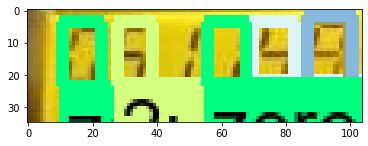

Detected numbers: 02489


In [55]:
# Read image
img = cv2.imread(IMAGE_PATH)
image_np = np.array(img)

# Get image size
image_height, image_width, _ = image_np.shape

# Convert image to tensor
input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)
detections = detect_fn(input_tensor)

# Process detections
num_detections = int(detections.pop('num_detections'))
detections = {key: value[0, :num_detections].numpy() for key, value in detections.items()}
detections['num_detections'] = num_detections

# detection_classes should be ints.
detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

label_id_offset = 1
image_np_with_detections = image_np.copy()

# Visualize the detections
viz_utils.visualize_boxes_and_labels_on_image_array(
    image_np_with_detections,
    detections['detection_boxes'],
    detections['detection_classes'] + label_id_offset,
    detections['detection_scores'],
    category_index,
    use_normalized_coordinates=True,
    max_boxes_to_draw=6,
    min_score_thresh=0.2,
    agnostic_mode=False
)

# Display the image
plt.imshow(cv2.cvtColor(image_np_with_detections, cv2.COLOR_BGR2RGB))
plt.show()

# Extract detected objects and their classes
boxes = detections['detection_boxes']
# Get all boxes from an array
max_boxes_to_draw = boxes.shape[0]
# Get scores to define a threshold
scores = detections['detection_scores']
# Set a default threshold
min_score_thresh = 0.25
result = []

# Define category index mapping
category_index_OCR2 = {
     1: {'id': 1, 'name': '0'},
     2: {'id': 2, 'name': '1'},
     3: {'id': 3, 'name': '2'},
     4: {'id': 4, 'name': '3'},
     5: {'id': 5, 'name': '4'},
     6: {'id': 6, 'name': '5'},
     7: {'id': 7, 'name': '6'},
     8: {'id': 8, 'name': '7'},
     9: {'id': 9, 'name': '8'},
    10: {'id': 10, 'name': '9'}
    # Add more class mappings as needed
}

# Iterate over all objects found
for i in range(min(max_boxes_to_draw, boxes.shape[0])):
    if scores is None or scores[i] > min_score_thresh:
        class_id = detections['detection_classes'][i] + label_id_offset
        if class_id in category_index_OCR2:
            class_name = category_index_OCR2[class_id]['name']
            result.append((boxes[i][1], class_name))

# Sort the results based on the y-coordinate
result.sort(key=lambda x: x[0])

# Combine the detected numbers into a single string
text = ''.join([item[1] for item in result])

print("Detected numbers:", text)


In [ ]:

# Set the path to the folder containing the images
IMAGE_FOLDER = os.path.join(paths['IMAGE_PATH'], 'test')

# Load the detection model and category index
# ...

# Get the list of image file names in the folder
image_files = os.listdir(IMAGE_FOLDER)

for image_file in image_files:
    # Read image
    image_path = os.path.join(IMAGE_FOLDER, image_file)
    img = cv2.imread(image_path)
    image_np = np.array(img)

    # Check if the image array has a valid shape
    if len(image_np.shape) != 3:
        #print("Invalid image shape. Skipping image:", image_path)
        continue

    # Get image size
    image_height, image_width, _ = image_np.shape

    # Convert image to tensor
    input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)
    detections = detect_fn(input_tensor)

    # Process detections
    num_detections = int(detections.pop('num_detections'))
    detections = {key: value[0, :num_detections].numpy() for key, value in detections.items()}
    detections['num_detections'] = num_detections

    # detection_classes should be ints
    detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

    # Extract detected objects and their classes
    boxes = detections['detection_boxes']
    max_boxes_to_draw = boxes.shape[0]
    scores = detections['detection_scores']
    min_score_thresh = 0.2
    result = []

    # Iterate over all objects found
    for i in range(min(max_boxes_to_draw, boxes.shape[0])):
        if scores is None or scores[i] > min_score_thresh:
            # Define category index mapping
            zero = 10
            category_index_OCR2 = {
                0: {'id': zero, 'name': '0'},
                1: {'id': 1, 'name': '1'},
                2: {'id': 2, 'name': '2'},
                3: {'id': 3, 'name': '3'},
                4: {'id': 4, 'name': '4'},
                5: {'id': 5, 'name': '5'},
                6: {'id': 6, 'name': '6'},
                7: {'id': 7, 'name': '7'},
                8: {'id': 8, 'name': '8'},
                9: {'id': 9, 'name': '9'},
                #10: {'id': 10, 'name': '10'},
                10: {'id': dot, 'name': '.'}
                # Add more class mappings as needed
            }

            class_name = category_index_OCR2.get(detections['detection_classes'][i] + 1, {}).get('name', '')
            result.append((boxes[i][1], detections['detection_classes'][i]))

    text = ''
    result2 = []
    for x in result:
        if x[0] not in [i[0] for i in result2]:
            result2.append(x)

    for i in sorted(result2):
        if int(i[1]) == 10:
            text += '.'
        else:
            text += str(i[1])

    # Visualize the detections on the image
    image_np_with_detections = image_np.copy()
    viz_utils.visualize_boxes_and_labels_on_image_array(
        image_np_with_detections,
        detections['detection_boxes'],
        detections['detection_classes'],
        detections['detection_scores'],
        category_index,
        use_normalized_coordinates=True,
        max_boxes_to_draw=6,
        min_score_thresh=0.2,
        agnostic_mode=False
    )

    # Display the image with detections
    plt.imshow(cv2.cvtColor(image_np_with_detections, cv2.COLOR_BGR2RGB))
    plt.title("Text: " + text)
    plt.axis('off')
    plt.show()


# 10. Real Time Detections from your Webcam

In [ ]:
!pip uninstall opencv-python-headless -y

In [14]:
cap = cv2.VideoCapture(0)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

while cap.isOpened(): 
    ret, frame = cap.read()
    image_np = np.array(frame)
    
    input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)
    detections = detect_fn(input_tensor)
    
    num_detections = int(detections.pop('num_detections'))
    detections = {key: value[0, :num_detections].numpy()
                  for key, value in detections.items()}
    detections['num_detections'] = num_detections

    # detection_classes should be ints.
    detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

    label_id_offset = 1
    image_np_with_detections = image_np.copy()

    viz_utils.visualize_boxes_and_labels_on_image_array(
                image_np_with_detections,
                detections['detection_boxes'],
                detections['detection_classes']+label_id_offset,
                detections['detection_scores'],
                category_index,
                use_normalized_coordinates=True,
                max_boxes_to_draw=5,
                min_score_thresh=.8,
                agnostic_mode=False)

    cv2.imshow('object detection',  cv2.resize(image_np_with_detections, (800, 600)))
    
    if cv2.waitKey(10) & 0xFF == ord('q'):
        cap.release()
        cv2.destroyAllWindows()
        break

# 10. Freezing the Graph

In [15]:
FREEZE_SCRIPT = os.path.join(paths['APIMODEL_PATH'], 'research', 'object_detection', 'exporter_main_v2.py ')

In [16]:
command = "python {} --input_type=image_tensor --pipeline_config_path={} --trained_checkpoint_dir={} --output_directory={}".format(FREEZE_SCRIPT ,files['PIPELINE_CONFIG'], paths['CHECKPOINT_PATH'], paths['OUTPUT_PATH'])

In [17]:
print(command)

python Tensorflow\models\research\object_detection\exporter_main_v2.py  --input_type=image_tensor --pipeline_config_path=Tensorflow\workspace\models\my_ssd_mobnet\pipeline.config --trained_checkpoint_dir=Tensorflow\workspace\models\my_ssd_mobnet --output_directory=Tensorflow\workspace\models\my_ssd_mobnet\export


In [18]:
!{command}

2021-04-03 11:51:42.281339: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library cudart64_110.dll
2021-04-03 11:51:44.712115: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-04-03 11:51:44.712813: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library nvcuda.dll
2021-04-03 11:51:44.734951: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:2b:00.0 name: GeForce RTX 2070 SUPER computeCapability: 7.5
coreClock: 1.785GHz coreCount: 40 deviceMemorySize: 8.00GiB deviceMemoryBandwidth: 417.29GiB/s
2021-04-03 11:51:44.734976: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library cudart64_110.dll
2021-04-03 11:51:44.738520: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library cublas64_11.dll
202

# 11. Conversion to TFJS

In [19]:
!pip install tensorflowjs

  Using cached tensorflowjs-3.3.0-py3-none-any.whl (63 kB)
  Using cached tensorflow_hub-0.9.0-py2.py3-none-any.whl (103 kB)
  Attempting uninstall: tensorflow-hub
    Found existing installation: tensorflow-hub 0.11.0
    Uninstalling tensorflow-hub-0.11.0:
      Successfully uninstalled tensorflow-hub-0.11.0


In [20]:
command = "tensorflowjs_converter --input_format=tf_saved_model --output_node_names='detection_boxes,detection_classes,detection_features,detection_multiclass_scores,detection_scores,num_detections,raw_detection_boxes,raw_detection_scores' --output_format=tfjs_graph_model --signature_name=serving_default {} {}".format(os.path.join(paths['OUTPUT_PATH'], 'saved_model'), paths['TFJS_PATH'])

In [21]:
print(command)

tensorflowjs_converter --input_format=tf_saved_model --output_node_names='detection_boxes,detection_classes,detection_features,detection_multiclass_scores,detection_scores,num_detections,raw_detection_boxes,raw_detection_scores' --output_format=tfjs_graph_model --signature_name=serving_default Tensorflow\workspace\models\my_ssd_mobnet\export\saved_model Tensorflow\workspace\models\my_ssd_mobnet\tfjsexport


In [22]:
!{command}

Writing weight file Tensorflow\workspace\models\my_ssd_mobnet\tfjsexport\model.json...


2021-04-03 11:54:23.153051: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library cudart64_110.dll
2021-04-03 11:54:25.644887: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-04-03 11:54:25.645576: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library nvcuda.dll
2021-04-03 11:54:25.667969: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:2b:00.0 name: GeForce RTX 2070 SUPER computeCapability: 7.5
coreClock: 1.785GHz coreCount: 40 deviceMemorySize: 8.00GiB deviceMemoryBandwidth: 417.29GiB/s
2021-04-03 11:54:25.668001: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library cudart64_110.dll
2021-04-03 11:54:25.671400: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library cublas64_11.dll
202

In [ ]:
# Test Code: https://github.com/nicknochnack/RealTimeSignLanguageDetectionwithTFJS

# 12. Conversion to TFLite

In [23]:
TFLITE_SCRIPT = os.path.join(paths['APIMODEL_PATH'], 'research', 'object_detection', 'export_tflite_graph_tf2.py ')

In [24]:
command = "python {} --pipeline_config_path={} --trained_checkpoint_dir={} --output_directory={}".format(TFLITE_SCRIPT ,files['PIPELINE_CONFIG'], paths['CHECKPOINT_PATH'], paths['TFLITE_PATH'])

In [25]:
print(command)

python Tensorflow\models\research\object_detection\export_tflite_graph_tf2.py  --pipeline_config_path=Tensorflow\workspace\models\my_ssd_mobnet\pipeline.config --trained_checkpoint_dir=Tensorflow\workspace\models\my_ssd_mobnet --output_directory=Tensorflow\workspace\models\my_ssd_mobnet\tfliteexport


In [26]:
!{command}

2021-04-03 11:55:05.530772: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library cudart64_110.dll
2021-04-03 11:55:08.004889: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-04-03 11:55:08.005672: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library nvcuda.dll
2021-04-03 11:55:08.028532: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:2b:00.0 name: GeForce RTX 2070 SUPER computeCapability: 7.5
coreClock: 1.785GHz coreCount: 40 deviceMemorySize: 8.00GiB deviceMemoryBandwidth: 417.29GiB/s
2021-04-03 11:55:08.028559: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library cudart64_110.dll
2021-04-03 11:55:08.032092: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library cublas64_11.dll
202

2021-04-03 11:55:14.884114: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1267]      0 
2021-04-03 11:55:14.884117: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1280] 0:   N 
2021-04-03 11:55:14.884182: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1406] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 6611 MB memory) -> physical GPU (device: 0, name: GeForce RTX 2070 SUPER, pci bus id: 0000:2b:00.0, compute capability: 7.5)
2021-04-03 11:55:14.884197: I tensorflow/compiler/jit/xla_gpu_device.cc:99] Not creating XLA devices, tf_xla_enable_xla_devices not set
W0403 11:55:15.360029 15552 save_impl.py:78] Skipping full serialization of Keras layer <object_detection.meta_architectures.ssd_meta_arch.SSDMetaArch object at 0x00000224AC2B1908>, because it is not built.
W0403 11:55:15.925411 15552 save_impl.py:78] Skipping full serialization of Keras layer <tensorflow.python.keras.layers.convolutional.SeparableConv2D object at 0x00000224D6D42B00>, bec

In [27]:
FROZEN_TFLITE_PATH = os.path.join(paths['TFLITE_PATH'], 'saved_model')
TFLITE_MODEL = os.path.join(paths['TFLITE_PATH'], 'saved_model', 'detect.tflite')

In [28]:
command = "tflite_convert \
--saved_model_dir={} \
--output_file={} \
--input_shapes=1,300,300,3 \
--input_arrays=normalized_input_image_tensor \
--output_arrays='TFLite_Detection_PostProcess','TFLite_Detection_PostProcess:1','TFLite_Detection_PostProcess:2','TFLite_Detection_PostProcess:3' \
--inference_type=FLOAT \
--allow_custom_ops".format(FROZEN_TFLITE_PATH, TFLITE_MODEL, )

In [29]:
print(command)

tflite_convert --saved_model_dir=Tensorflow\workspace\models\my_ssd_mobnet\tfliteexport\saved_model --output_file=Tensorflow\workspace\models\my_ssd_mobnet\tfliteexport\saved_model\detect.tflite --input_shapes=1,300,300,3 --input_arrays=normalized_input_image_tensor --output_arrays='TFLite_Detection_PostProcess','TFLite_Detection_PostProcess:1','TFLite_Detection_PostProcess:2','TFLite_Detection_PostProcess:3' --inference_type=FLOAT --allow_custom_ops


In [30]:
!{command}

2021-04-03 11:55:38.653963: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library cudart64_110.dll
2021-04-03 11:55:41.159460: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-04-03 11:55:41.160164: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library nvcuda.dll
2021-04-03 11:55:41.183623: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:2b:00.0 name: GeForce RTX 2070 SUPER computeCapability: 7.5
coreClock: 1.785GHz coreCount: 40 deviceMemorySize: 8.00GiB deviceMemoryBandwidth: 417.29GiB/s
2021-04-03 11:55:41.183649: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library cudart64_110.dll
2021-04-03 11:55:41.187402: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library cublas64_11.dll
202

# 13. Zip and Export Models 

In [ ]:
!tar -czf models.tar.gz {paths['CHECKPOINT_PATH']}

In [ ]:
from google.colab import drive
drive.mount('/content/drive')